<a href="https://colab.research.google.com/github/nssingh-ml/tifr/blob/main/unet_%2B%2B_brain_MRI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Kaggle connection

In [ ]:
!pip install kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
!kaggle datasets download -d mateuszbuda/lgg-mri-segmentation

Dataset URL: https://www.kaggle.com/datasets/mateuszbuda/lgg-mri-segmentation
License(s): CC-BY-NC-SA-4.0
 99% 709M/714M [00:07<00:00, 127MB/s]
100% 714M/714M [00:07<00:00, 95.3MB/s]


In [ ]:
!unzip lgg-mri-segmentation.zip

Streaming output truncated to the last 5000 lines.
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7294_19890104/TCGA_DU_7294_19890104_9_mask.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_1.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_10.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_10_mask.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_11.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_11_mask.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_12.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_12_mask.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_19910324/TCGA_DU_7298_19910324_13.tif  
  inflating: lgg-mri-segmentation/kaggle_3m/TCGA_DU_7298_1

temp

In [ ]:
# import os
# save_dir = '/content/drive/My Drive/tifr_notebook/kaggle_3m'
# os.makedirs(save_dir, exist_ok=True)

In [ ]:
# !cp -r kaggle_3m '/content/drive/My Drive/tifr_notebook/kaggle_3m'

##dataset

In [ ]:
import glob
brain_scans = []
dataset_path = "/content/kaggle_3m/"
mask_files = glob.glob(dataset_path + '*/*_mask*')

for i in mask_files:
    brain_scans.append(i.replace('_mask',''))

print(brain_scans[:10])
print(mask_files[:10])

['/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_12.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_1.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_11.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_18.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_8.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_7.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_16.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_13.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_17.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_14.tif']
['/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_12_mask.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_1_mask.tif', '/content/kaggle_3m/TCGA_HT_7874_19950902/TCGA_HT_7874_19950902_11_mask.tif', '/content/kaggle_3m/TCGA_HT_7874_19950

In [ ]:
import pandas as pd
img_df = pd.DataFrame({
    "image_path":brain_scans,
    "mask_path":mask_files
})

In [ ]:
import cv2
import numpy as np
def positive_negative_diagnosis(file_masks):
    mask = cv2.imread(file_masks)
    value = np.max(mask)
    if value > 0:
        return 1
    else:
        return 0

img_df["Tumor"] = img_df["mask_path"].apply(lambda x: positive_negative_diagnosis(x))

In [ ]:
img_df["Tumor"].value_counts()

Tumor
0    2556
1    1373
Name: count, dtype: int64

Plot of some dataset images with coresponding mask and MRI scan with their mask

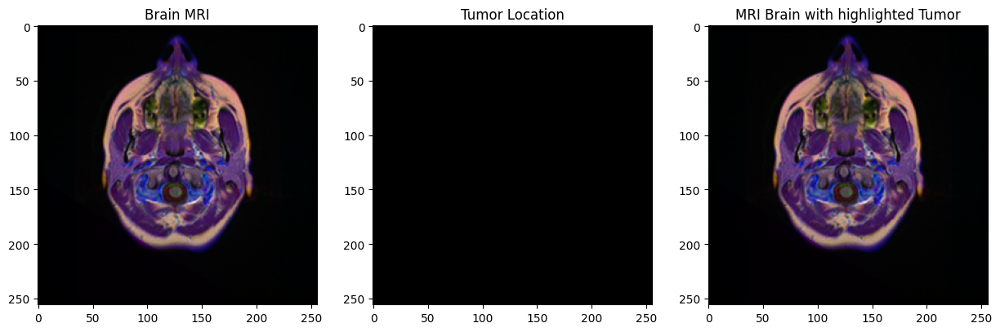

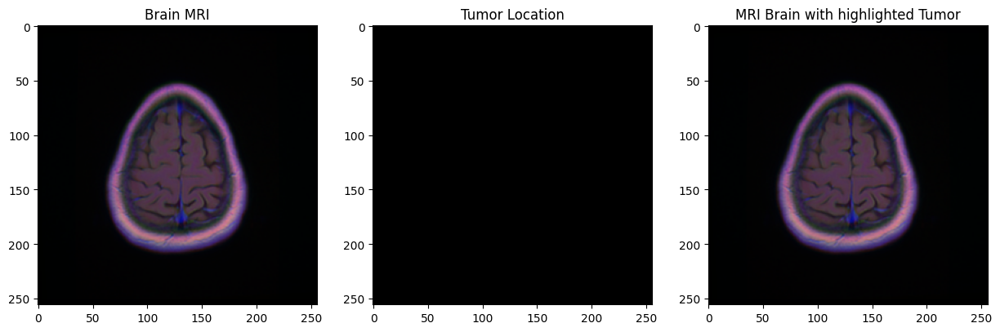

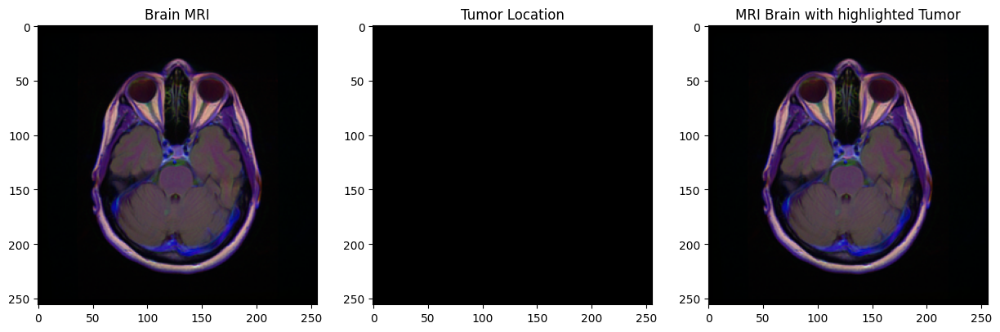

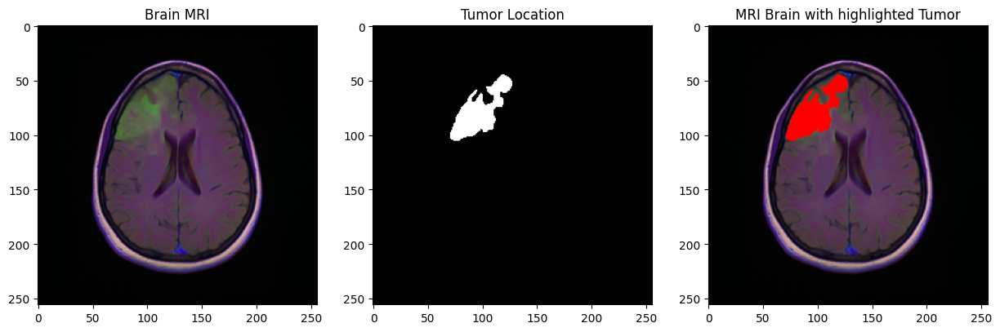

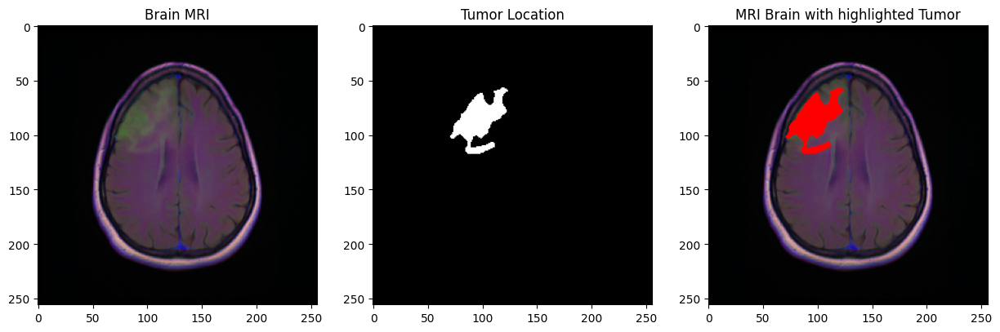

...

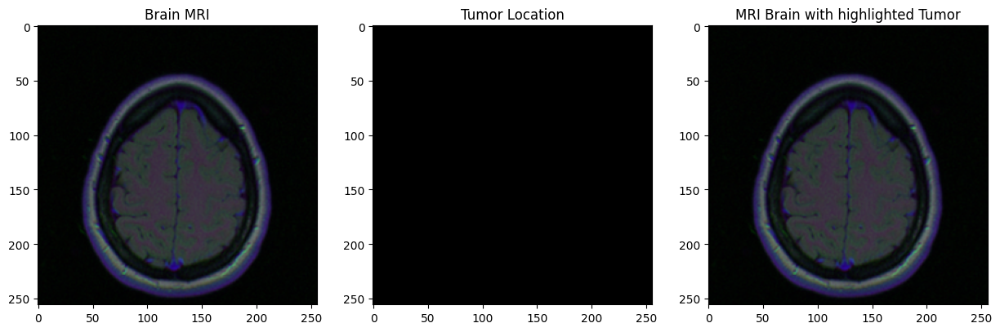

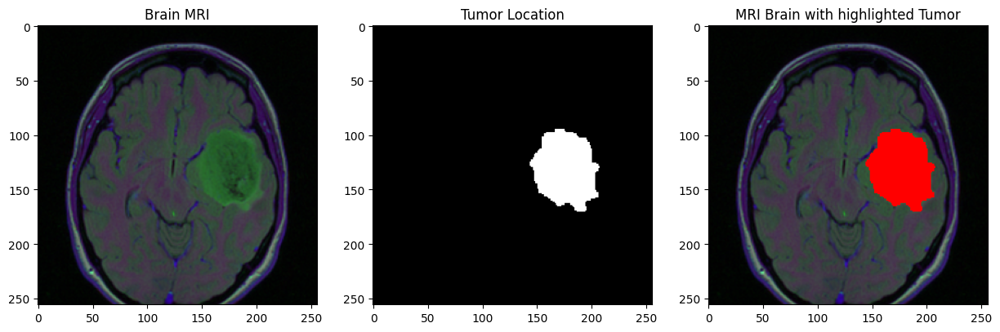

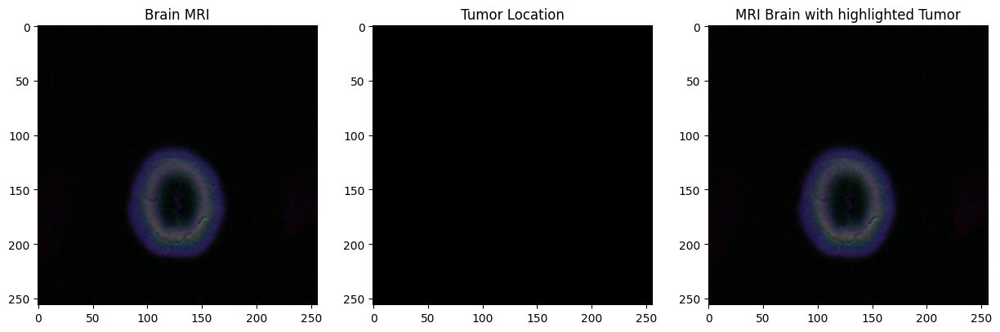

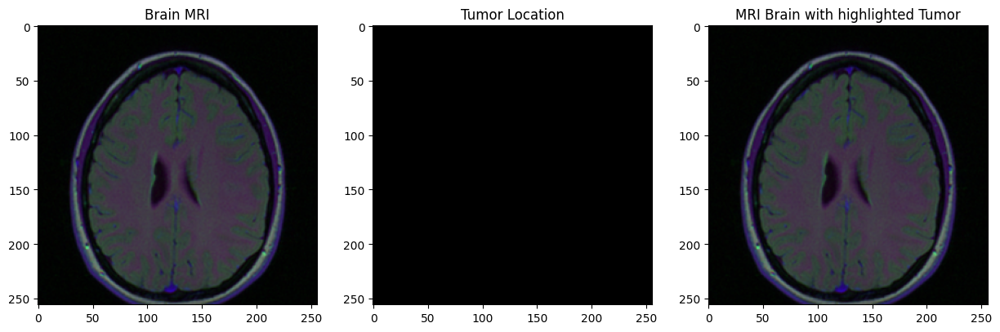

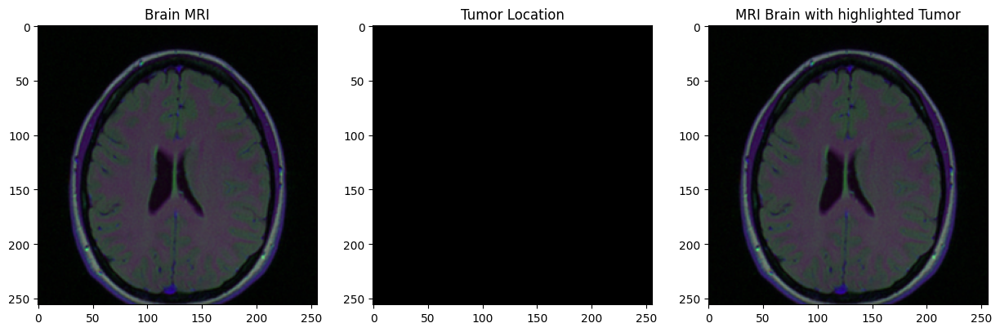

In [ ]:
import matplotlib.pyplot as plt

for i in range(1,40, 2):
    img_path=brain_scans[i]
    msk_path=mask_files[i]
    img=cv2.imread(img_path)
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    msk=cv2.imread(msk_path)

    #Plot the Brain MRI scans
    original = img.copy()
    fig, ax = plt.subplots(1,3,figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")

    # Plot the corresponding mask
    main = original.copy()
    mask = msk.copy()
    ax[1].imshow(mask)
    ax[1].set_title("Tumor Location")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    ax[2].imshow(sample_over_gt)
    ax[2].set_title("MRI Brain with highlighted Tumor")

In [ ]:
img_df.shape
# train.head()

(3929, 3)

In [ ]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(img_df[:2000],test_size = 0.1)
train, val = train_test_split(train,test_size = 0.2)
print(train.values.shape)
print(val.values.shape)
print(test.values.shape)

train.head()
val.head()

(1440, 3)
(360, 3)
(200, 3)


,image_path,mask_path,Tumor
1005,/content/kaggle_3m/TCGA_HT_7881_19981015/TCGA_...,/content/kaggle_3m/TCGA_HT_7881_19981015/TCGA_...,1
791,/content/kaggle_3m/TCGA_DU_7294_19890104/TCGA_...,/content/kaggle_3m/TCGA_DU_7294_19890104/TCGA_...,0
1114,/content/kaggle_3m/TCGA_FG_6690_20020226/TCGA_...,/content/kaggle_3m/TCGA_FG_6690_20020226/TCGA_...,0
1988,/content/kaggle_3m/TCGA_DU_5852_19950709/TCGA_...,/content/kaggle_3m/TCGA_DU_5852_19950709/TCGA_...,0
656,/content/kaggle_3m/TCGA_HT_7475_19970918/TCGA_...,/content/kaggle_3m/TCGA_HT_7475_19970918/TCGA_...,1


In [ ]:
train.iloc[i, 2]

1

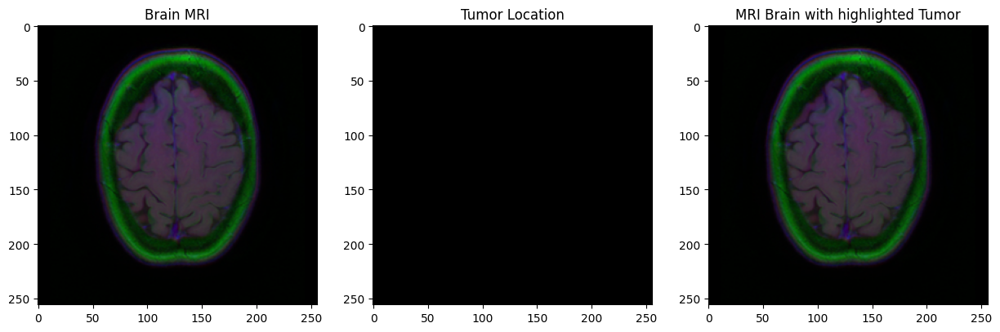

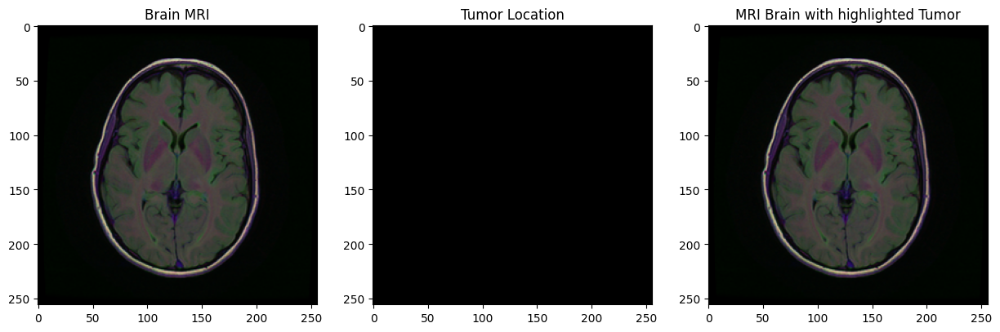

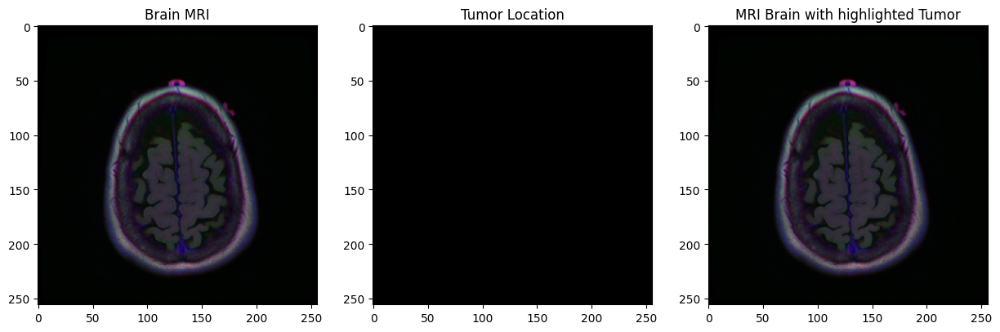

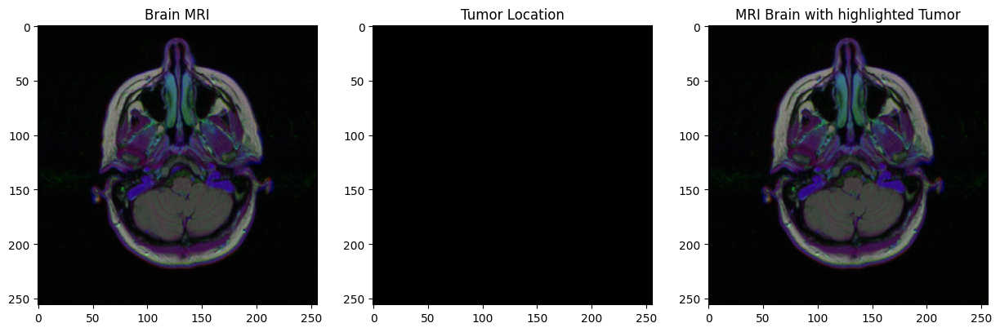

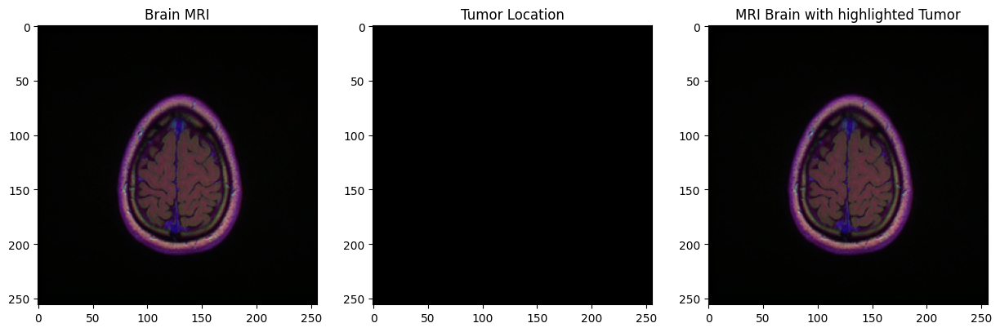

...

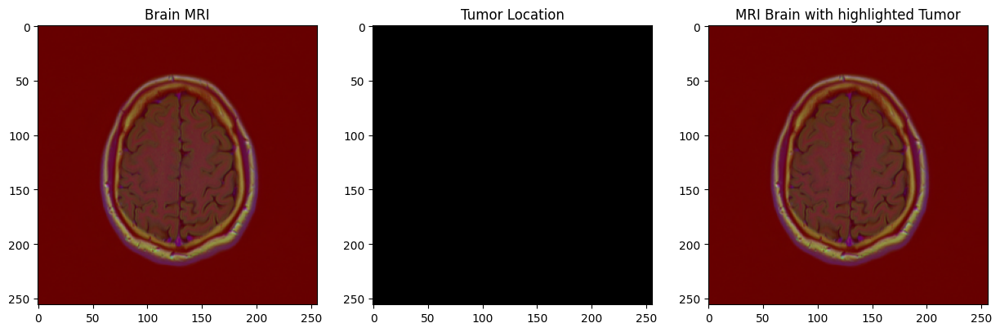

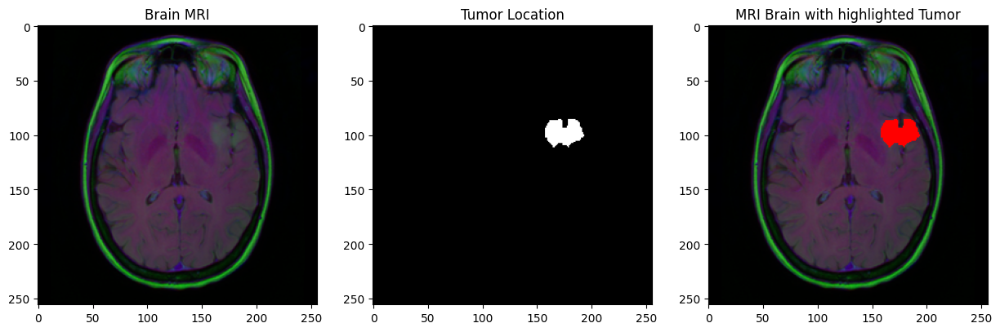

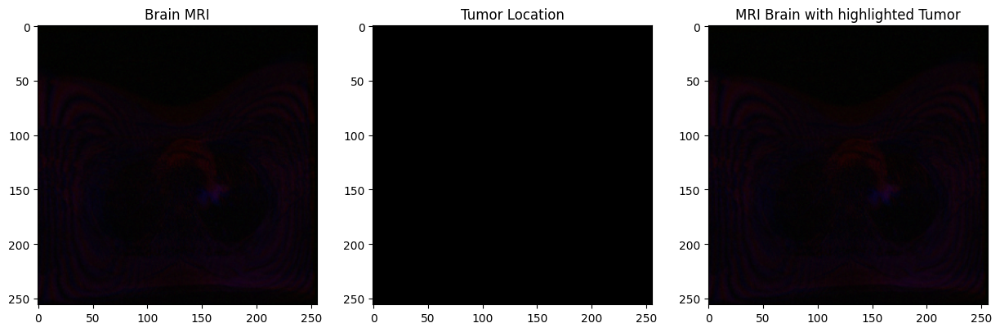

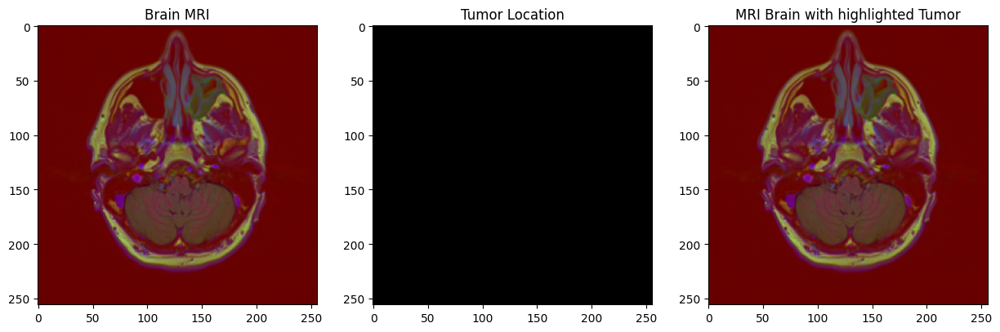

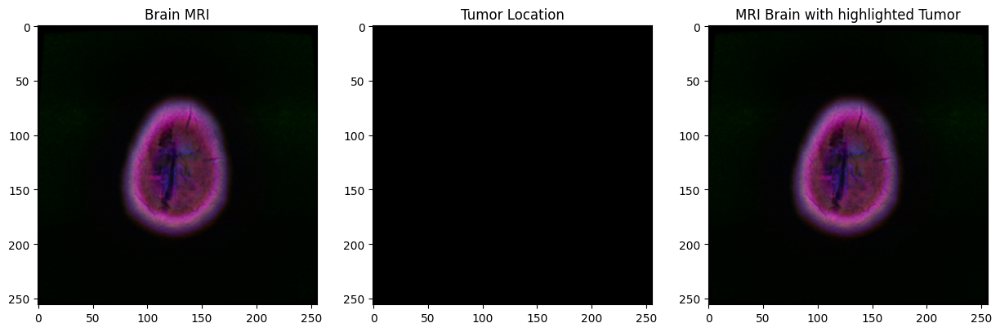

In [ ]:
# img_path_test = train.iloc[i, 0]
# msk_path_test = train.iloc[i, 1]
for i in range(1,40, 2):
    img_path=test.iloc[i, 0]
    msk_path=test.iloc[i, 1]
    img=cv2.imread(img_path)
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    msk=cv2.imread(msk_path)

    #Plot the Brain MRI scans
    original = img.copy()
    fig, ax = plt.subplots(1,3,figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")

    # Plot the corresponding mask
    main = original.copy()
    mask = msk.copy()
    ax[1].imshow(mask)
    ax[1].set_title("Tumor Location")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    ax[2].imshow(sample_over_gt)
    ax[2].set_title("MRI Brain with highlighted Tumor")

In [ ]:
val["Tumor"].value_counts()

Tumor
0    235
1    125
Name: count, dtype: int64

In [ ]:
img_df['Tumor'] = img_df['Tumor'].apply(lambda x: str(x))
img_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3929 entries, 0 to 3928
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  3929 non-null   object
 1   mask_path   3929 non-null   object
 2   Tumor       3929 non-null   object
dtypes: object(3)
memory usage: 92.2+ KB


In [ ]:
# SOURCE: https://github.com/zhixuhao/unet/blob/master/data.py
from keras.preprocessing.image import ImageDataGenerator


def train_generator(data_frame, batch_size, aug_dict,
        image_color_mode="rgb",
        mask_color_mode="grayscale",
        image_save_prefix="image",
        mask_save_prefix="mask",
        save_to_dir=None,
        target_size=(128,128),
        seed=1):
    '''
    can generate image and mask at the same time use the same seed for
    image_datagen and mask_datagen to ensure the transformation for image
    and mask is the same if you want to visualize the results of generator,
    set save_to_dir = "your path"
    '''
    image_datagen = ImageDataGenerator(**aug_dict)
    mask_datagen = ImageDataGenerator(**aug_dict)

    image_generator = image_datagen.flow_from_dataframe(
        data_frame,
        x_col = "image_path",
        class_mode = None,
        color_mode = image_color_mode,
        target_size = target_size,
        batch_size = batch_size,
        save_to_dir = save_to_dir,
        save_prefix  = image_save_prefix,
        seed = seed)

    mask_generator = mask_datagen.flow_from_dataframe(
        data_frame,
        x_col = "mask_path",
        class_mode = None,
        color_mode = mask_color_mode,
        target_size = target_size,
        batch_size = batch_size,
        save_to_dir = save_to_dir,
        save_prefix  = mask_save_prefix,
        seed = seed)

    train_gen = zip(image_generator, mask_generator)

    for (img, mask) in train_gen:
        img, mask = adjust_data(img, mask)
        yield (img,mask)

def adjust_data(img,mask):
    img = img / 255
    mask = mask / 255
    mask[mask > 0.5] = 1
    mask[mask <= 0.5] = 0

    return (img, mask)

## connet to drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Models

In [ ]:
EPOCHS = 50
BATCH_SIZE = 32
im_height = 128
im_width = 128

In [ ]:
train_generator_args = dict(width_shift_range=0.05,
                            height_shift_range=0.05,
                            zoom_range=0.05,
                            horizontal_flip=True,
                            fill_mode='nearest'
                           )


train_gen = train_generator(train, BATCH_SIZE,
                            train_generator_args,
                            target_size=(im_height,
                            im_width)
                           )


test_gen = train_generator(val, BATCH_SIZE,
                            dict(),
                            target_size=(im_height, im_width)
                            )

## Loss

According to the paper, the U-Net++ model was optimized on the combined loss of binary cross-entropy and dice coefficient. This can be defined as:
\begin{align*}
\mathcal{L}_{\text{combined}} &= \alpha \cdot \mathcal{L}_{\text{Dice}} + \beta \cdot \mathcal{L}_{\text{BCE}} \\
\text{where,} \\
\mathcal{L}_{\text{Dice}} &= 1 - \frac{2 \sum_{i=1}^{N} p_i g_i + \epsilon}{\sum_{i=1}^{N} p_i + \sum_{i=1}^{N} g_i + \epsilon} \\
\mathcal{L}_{\text{BCE}} &= - \frac{1}{N} \sum_{i=1}^{N} \left[ g_i \log(p_i) + (1 - g_i) \log(1 - p_i) \right] \\
\text{and} \\
p_i &= \text{predicted probability for the $i$-th pixel} \\
g_i &= \text{ground truth label for the $i$-th pixel} \\
\alpha, \beta &\in \mathbb{R}^{+} \quad \text{(weights for balancing the loss components)} \\
\epsilon &\text{ is a small constant to avoid division by zero (e.g., $10^{2}$)}
\end{align*}

In [ ]:
import tensorflow as tf
from keras import backend as K

smooth = 100.0

def dice_coef(y_true, y_pred):
    if y_true.shape != y_pred.shape:
      y_pred = tf.nn.sigmoid(y_pred)

      # Ensure y_true and y_pred are the same shape
      y_true = tf.reshape(y_true, tf.shape(y_pred))
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2.0 * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

def dice_coef_loss(y_true, y_pred):
    y_pred = tf.nn.sigmoid(y_pred)
    return -dice_coef(y_true, y_pred)

def iou(y_true, y_pred):

  y_true = tf.cast(y_true, tf.float32)
  y_pred = tf.cast(y_pred, tf.float32)

  if y_true.shape != y_pred.shape:
        y_pred = tf.reshape(y_pred, tf.shape(y_true))

  intersection = tf.reduce_sum(y_true * y_pred)

  union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) - intersection

  # iou_score = intersection / union
  iou_score = tf.cond(
        tf.equal(union, 0),
        lambda: tf.constant(1.0),  # Return IoU of 1 when both masks are empty
        lambda: intersection / union
    )

  return iou_score

def jac_distance(y_true, y_pred):
    return 1 - iou(y_true, y_pred)


def custom_binary_accuracy(y_true, y_pred):
    #  "Ensure predictions are in binary format (0 or 1)"
    y_pred = tf.cast(tf.math.greater_equal(y_pred, 0.5), tf.float32)

    # Compare predictions to true labels and calculate accuracy"
    correct_predictions = tf.equal(y_true, y_pred)
    # print("system")
    accuracy = tf.reduce_mean(tf.cast(correct_predictions, tf.float32))

    return accuracy

In [ ]:
def combined_loss(y_true, y_pred):
    # Apply sigmoid to predictions to get probabilities
    y_pred = tf.nn.sigmoid(y_pred)

    # Ensure y_true and y_pred are the same shape
    y_true = tf.reshape(y_true, tf.shape(y_pred))

    # Ensure y_true and y_pred have the same number of channels
    y_true_channels = K.int_shape(y_true)[-1]
    y_pred_channels = K.int_shape(y_pred)[-1]
    if y_true_channels != y_pred_channels:
        raise ValueError("Number of channels in y_true and y_pred must match.")

    # Calculate binary crossentropy
    bce = tf.keras.losses.binary_crossentropy(y_true, y_pred)

    # Calculate dice coefficient
    dice = dice_coef(y_true, y_pred)

    # Combine losses
    return 0.5 * bce + 0.5 * (1 - dice)

## Imports

In [ ]:
import os
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, LearningRateScheduler

## Unet++

In [ ]:
def conv_block(input_size, filters):
  x= tf.keras.Sequential([
      tf.keras.layers.Conv2D(filters,3,padding = 'same'),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.Activation('relu'),
      tf.keras.layers.Conv2D(filters, 3, padding='same'),
      tf.keras.layers.BatchNormalization(),
      tf.keras.layers.Activation('relu'),
  ])(input_size)

  return x

In [ ]:
#creating directory if not exists
save_dir = '/content/drive/My Drive/tifr_notebook'
os.makedirs(save_dir, exist_ok=True)

### without using deep supervision

In [ ]:
save_dir = '/content/drive/My Drive/tifr_notebook/unet++'
os.makedirs(save_dir, exist_ok=True)

In [ ]:
def unet_plus(input=(256,256,3), num_classes=1, deep_supervision = True):
  input_shape= tf.keras.layers.Input(shape=input)

  #encoding
  x_00 = conv_block(input_shape,64)
  x_10 = conv_block(tf.keras.layers.MaxPool2D()(x_00), 128)
  x_20 = conv_block(tf.keras.layers.MaxPool2D()(x_10), 256)
  x_30 = conv_block(tf.keras.layers.MaxPool2D()(x_20), 512)
  x_40 = conv_block(tf.keras.layers.MaxPool2D()(x_30), 1024)

  #skip connection

  x_01 = conv_block(tf.keras.layers.concatenate([x_00, tf.keras.layers.UpSampling2D()(x_10)]), 64)
  x_11 = conv_block(tf.keras.layers.concatenate([x_10, tf.keras.layers.UpSampling2D()(x_20)]), 128)
  x_21 = conv_block(tf.keras.layers.concatenate([x_20, tf.keras.layers.UpSampling2D()(x_30)]), 256)
  x_31 = conv_block(tf.keras.layers.concatenate([x_30, tf.keras.layers.UpSampling2D()(x_40)]), 512)

  x_02 = conv_block(tf.keras.layers.concatenate([
      x_00,x_01,tf.keras.layers.UpSampling2D()(x_11)]), 64)
  x_12 = conv_block(tf.keras.layers.concatenate([x_10,x_11, tf.keras.layers.UpSampling2D()(x_21)]), 128)
  x_22 = conv_block(tf.keras.layers.concatenate([x_20,x_21, tf.keras.layers.UpSampling2D()(x_31)]), 256)

  x_03 = conv_block(tf.keras.layers.concatenate([
      x_00,x_01,x_02, tf.keras.layers.UpSampling2D()(x_12)
  ]), 64)
  x_13 = conv_block(tf.keras.layers.concatenate([
      x_10,x_11,x_12, tf.keras.layers.UpSampling2D()(x_22)
  ]), 128)

  x_04 = conv_block(tf.keras.layers.concatenate([
      x_00,x_01,x_02,x_03,tf.keras.layers.UpSampling2D()(x_13)
  ]),64)


  if deep_supervision:
    output = [
        tf.keras.layers.Conv2D(num_classes,1)(x_01),
        tf.keras.layers.Conv2D(num_classes,1)(x_02),
        tf.keras.layers.Conv2D(num_classes,1)(x_03),
        tf.keras.layers.Conv2D(num_classes,1)(x_04)
    ]

    output = tf.keras.layers.concatenate(output, axis=3)
    output = tf.keras.layers.Conv2D(num_classes, 1)(output)

  else:
    output = tf.keras.layers.Conv2D(num_classes,1)(x_04)

  model = tf.keras.Model(inputs=input_shape, outputs= output, name = 'unet_plus')


  return model



model = unet_plus()
model.summary()

Model: "unet_plus"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 256, 256, 64)         39232     ['input_1[0][0]']             
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['sequential[0][0]']          
 D)                                                                                               
                                                                                                  
 sequential_1 (Sequential)   (None, 128, 128, 128)        222464    ['max_pooling2d[0][0]'

In [ ]:
# Define reducelr function to reduce learning rate
reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                              mode='min',
                              verbose=1,
                              patience=15,
                              min_delta=0.0001,
                              factor=0.2
                             )

# Define the earltstop function
earlystopping = EarlyStopping(monitor='val_loss',
                              min_delta=0.001,
                              mode='min',
                              verbose=1,
                              patience=20,
                              restore_best_weights = True
                             )

# Defining the Callbacks Function
checkpointer2 = [ModelCheckpoint(f'{save_dir}/unet++_brain_mri_seg.hdf5', verbose=1, save_best_only=True)]
callbacks = [checkpointer2, earlystopping, reduce_lr]

In [ ]:
model = unet_plus(input=(im_height, im_width, 3),num_classes=1, deep_supervision= False)

# print(BATCH_SIZE)
model.compile(optimizer='adam', loss=combined_loss, metrics=[custom_binary_accuracy, iou, dice_coef])
history = model.fit(train_gen,
                    steps_per_epoch = len(train) / BATCH_SIZE,
                    epochs=EPOCHS,
                    validation_data = test_gen,
                    validation_steps = len(val) / BATCH_SIZE,
                    callbacks = callbacks)

Found 1440 validated image filenames.
Found 1440 validated image filenames.
Epoch 1/50
45/45 [==============================] - ETA: 0s - loss: 0.4272 - custom_binary_accuracy: 0.9849 - iou: -0.0130 - dice_coef: 0.2438Found 360 validated image filenames.
Found 360 validated image filenames.

Epoch 1: val_loss improved from inf to 14.46454, saving model to /content/drive/My Drive/tifr_notebook/unet++/unet++_brain_mri_seg.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


45/45 [==============================] - 96s 2s/step - loss: 0.4272 - custom_binary_accuracy: 0.9849 - iou: -0.0130 - dice_coef: 0.2438 - val_loss: 14.4645 - val_custom_binary_accuracy: 0.0489 - val_iou: 0.0365 - val_dice_coef: 0.0204 - lr: 0.0010
Epoch 2/50
45/45 [==============================] - ETA: 0s - loss: 0.2892 - custom_binary_accuracy: 0.9910 - iou: -0.0137 - dice_coef: 0.4724
Epoch 2: val_loss improved from 14.46454 to 6.08114, saving model to /content/drive/My Drive/tifr_notebook/unet++/unet++_brain_mri_seg.hdf5
45/45 [==============================] - 74s 2s/step - loss: 0.2892 - custom_binary_accuracy: 0.9910 - iou: -0.0137 - dice_coef: 0.4724 - val_loss: 6.0811 - val_custom_binary_accuracy: 0.1572 - val_iou: 0.0345 - val_dice_coef: 0.0237 - lr: 0.0010
Epoch 3/50
45/45 [==============================] - ETA: 0s - loss: 0.2268 - custom_binary_accuracy: 0.9927 - iou: -0.0146 - dice_coef: 0.5916
Epoch 3: val_loss did not improve from 6.08114
45/45 [=========================

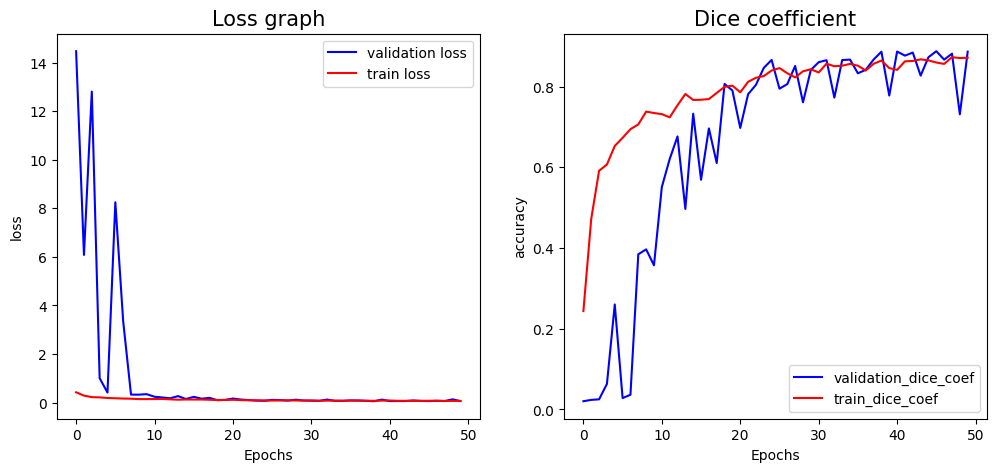

In [ ]:
 import matplotlib.pyplot as plt

history = history.history

list_traindice = history['dice_coef']
list_valdice = history['val_dice_coef']

list_trainjaccard = history['iou']
list_valjaccard = history['val_iou']

list_trainloss = history['loss']
list_valloss = history['val_loss']

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(list_valloss, 'b-', label='validation loss')
plt.plot(list_trainloss,'r-', label='train loss')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title('Loss graph', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(list_valdice, 'b-', label= 'validation_dice_coef')
plt.plot(list_traindice, 'r-', label= 'train_dice_coef')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('Dice coefficient', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
# plt.show()
plot_filename = os.path.join(save_dir, f'Dice coefficient Loss graph.png')
plt.savefig(plot_filename)
plt.show()



In [ ]:
import pickle

# Save the history as a pickle file in the specified directory
with open(save_dir + '/history_adam.pkl', 'wb') as f:
    pickle.dump(history, f)



In [ ]:
from tensorflow.keras.models import Model, load_model, save_model
model = unet_plus(input=(im_height, im_width, 3),num_classes=1, deep_supervision=False)
model.load_weights(f'{save_dir}/unet++_brain_mri_seg.hdf5')
model.compile(optimizer='adam', loss=combined_loss, metrics=[custom_binary_accuracy, iou, dice_coef])

In [ ]:
test_gen = train_generator(test,
                           BATCH_SIZE,
                           dict(),
                           target_size=(im_height, im_width))

results = model.evaluate(test_gen,
                         steps=len(test) / BATCH_SIZE)

print("Test lost: ",results[0])
print("Test IOU: ",results[1])
print("Test Dice Coefficent: ",results[2])

Found 200 validated image filenames.
Found 200 validated image filenames.
6/6 [==============================] - 30s 2s/step - loss: 0.0820 - custom_binary_accuracy: 0.9980 - iou: -0.0045 - dice_coef: 0.8410
Test lost:  0.08204364031553268
Test IOU:  0.9979801177978516
Test Dice Coefficent:  -0.00452917767688632


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 40ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 83ms/step


1/1 [==============================] - 0s 38ms/step


1/1 [==============================] - 0s 38ms/step


1/1 [==============================] - 0s 36ms/step


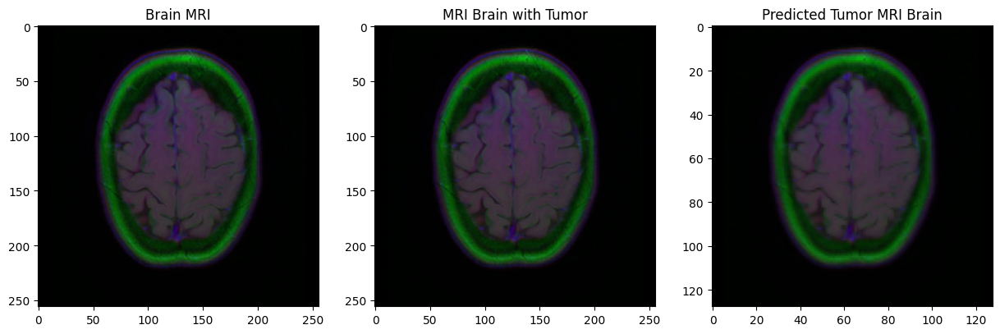

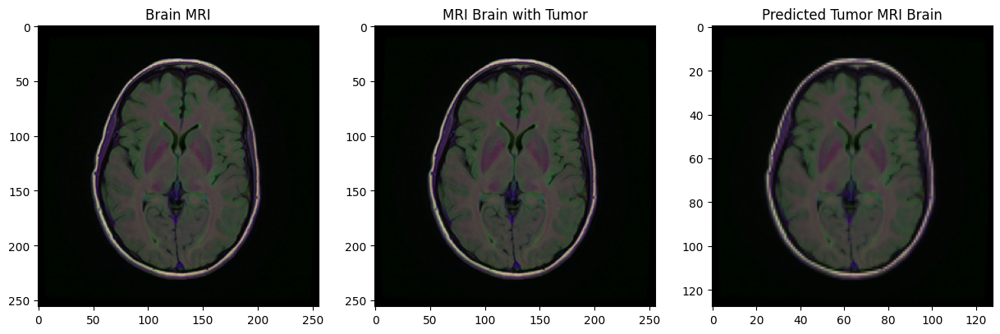

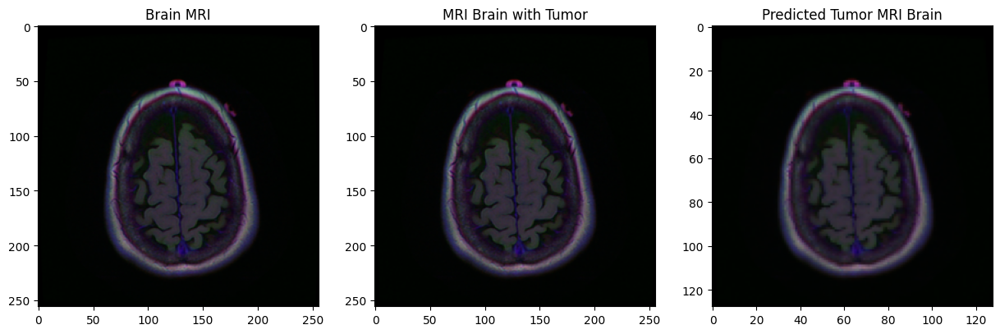

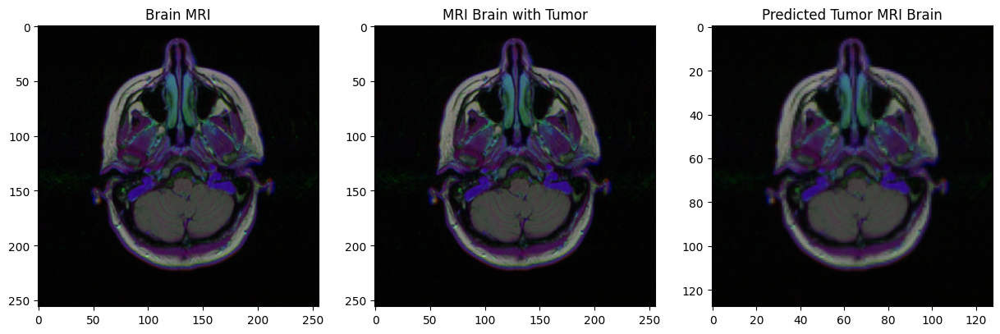

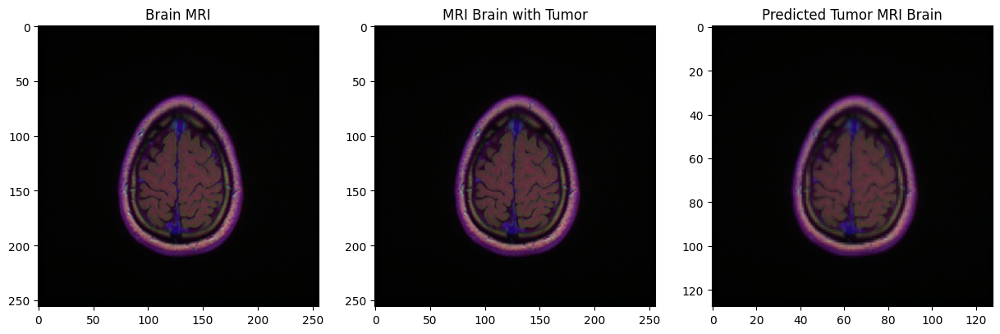

...

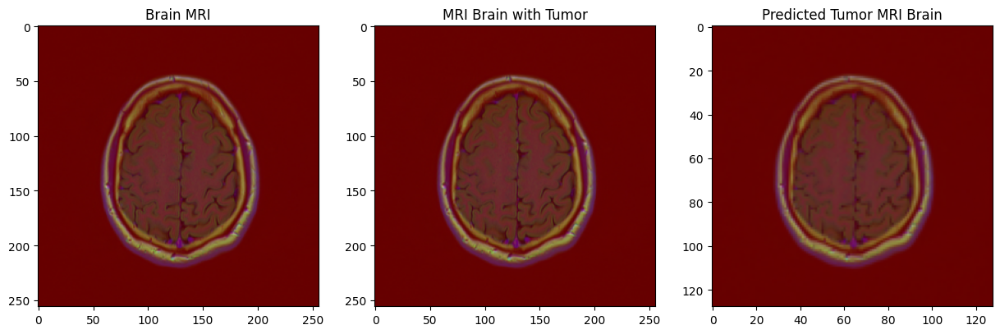

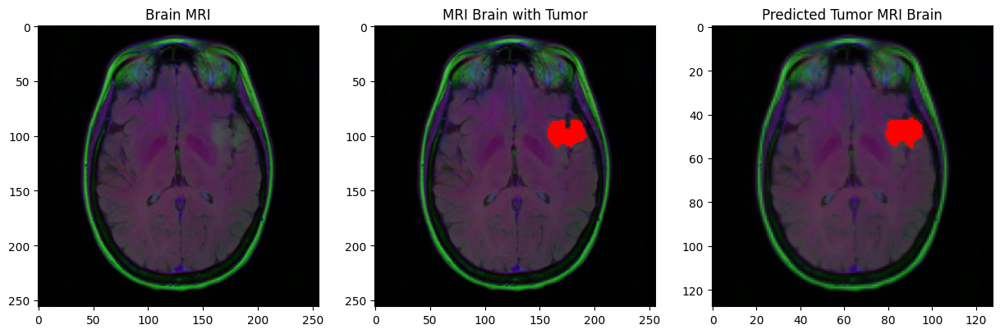

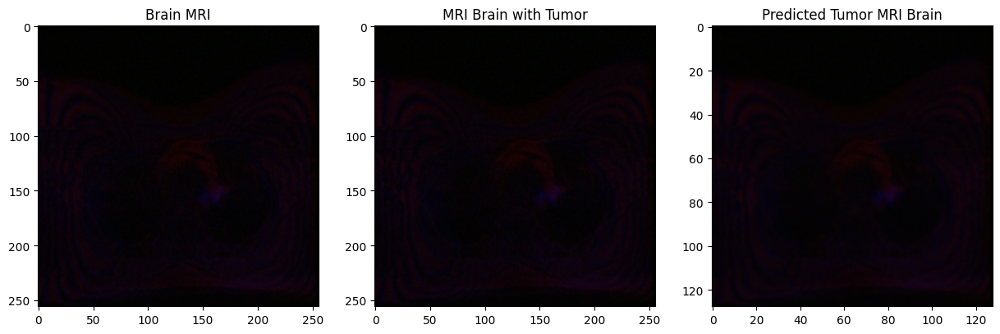

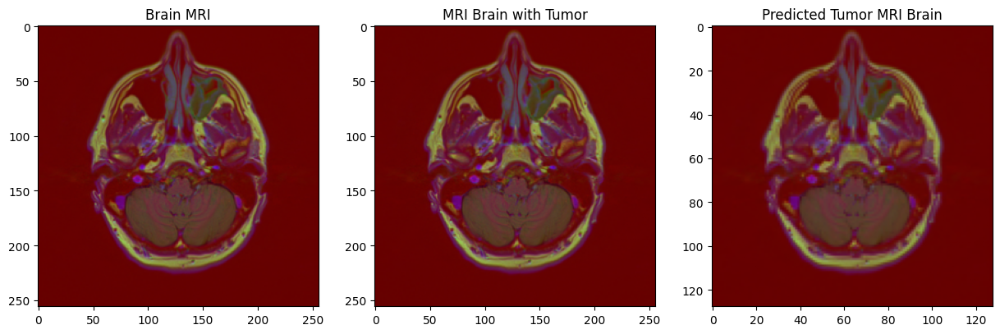

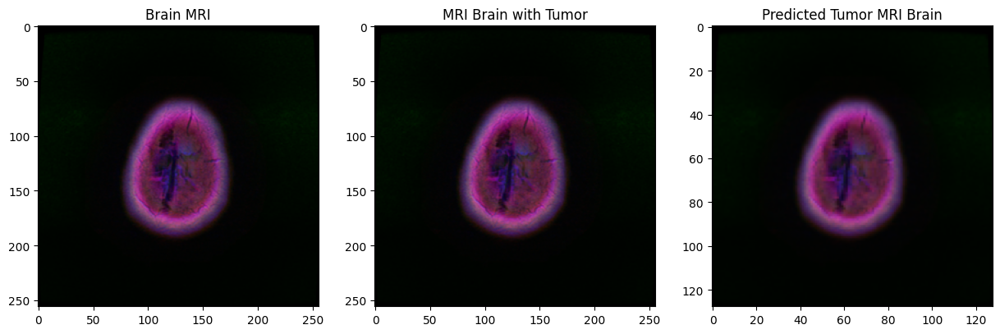

In [ ]:
for i in range(1,40,2):
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

    img1 = img.copy()
    img1 = cv2.resize(img1, (256, 256))
    img1 = img1 / 255.0
    img1_for_plotting = img1.copy()


    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    msk= cv2.imread(msk_path_test)
    pred = model.predict(img) #predictions
    img = np.squeeze(img)

    #Plot the Brain MRI scans
    original = img1_for_plotting.copy()
    fig, ax = plt.subplots(1,3, figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path_test)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    ax[1].imshow(np.squeeze(sample_over_gt))
    ax[1].set_title("MRI Brain with Tumor")

    #Plot the predicted mask on the Brain MRI Scan
    main = img.copy()
    sample = np.array(np.squeeze(pred) > 0.5, dtype = np.uint8)
    contours, hier = cv2.findContours(sample,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_pr = cv2.drawContours(main, contours, -1, [255,0,0], thickness=-1)
    ax[2].imshow(np.squeeze(sample_over_pr))
    ax[2].set_title("Predicted Tumor MRI Brain")

In [ ]:
import matplotlib.pyplot as plt
plt.style.use("ggplot")
%matplotlib inline
for i in range(30):
    index=np.random.randint(1,len(test.index))
    img = cv2.imread(test.iloc[index,0])
    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    pred=model.predict(img)

    plt.figure(figsize=(12,12))
    plt.subplot(1,3,1)
    plt.imshow(np.squeeze(img))
    plt.title('Original Image')

    plt.subplot(1,3,2)
    msk = cv2.imread(test.iloc[index,1])
    msk = cv2.resize(msk ,(im_height, im_width))
    msk = msk / 255
    msk = msk[np.newaxis, :, :, :]
    plt.imshow(np.squeeze(msk))
    # plt.imshow(np.squeeze(cv2.imread(test.iloc[index,1])))
    plt.title('Original Mask')
    plt.subplot(1,3,3)
    plt.imshow(np.squeeze(pred) > .5)
    plt.title('Prediction')
    plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Initialize lists to store loss values and image indices
loss_values = []
image_indices = []

# Iterate through the test images
for i in range(min(len(test),30000)):
    image, mask = next(test_gen)

    # Obtain the prediction from the model
    prediction = model.predict(image)

    # Calculate the loss between the predicted mask and the ground truth mask
    loss_tensor = combined_loss(mask, prediction)
    loss = tf.reduce_mean(loss_tensor).numpy()
     # You need to define this function
    # print(loss)

    # Append the loss value and image index to the lists
    loss_values.append(loss)
    image_indices.append(i)

1/1 [==============================] - 0s 28ms/step


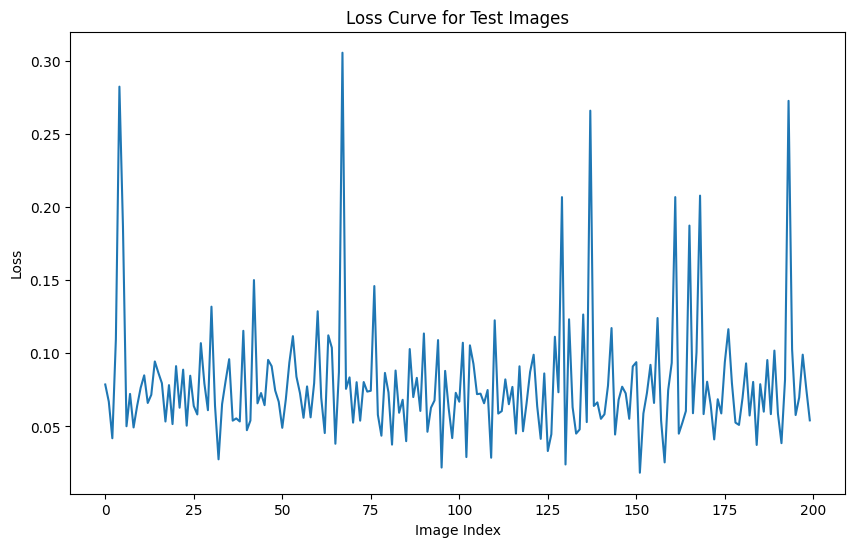

In [ ]:
# plt.subplot(1,4,4)
plt.figure(figsize=(10, 6))
plt.plot(image_indices, loss_values)
plt.xlabel('Image Index')
plt.ylabel('Loss')
plt.title('Loss Curve for Test Images')
# plt.grid(True)

plot_filename = os.path.join(save_dir, f'Loss Curve for Test Images')
plt.savefig(plot_filename)
plt.show()


In [ ]:
# Lists to store Dice and IoU scores
dice_scores = []
iou_scores = []

# Assuming test is a pandas DataFrame with paths to test images and masks
for i in range(len(test)):
    image, mask = next(test_gen)


    # Predictions
    preds = model.predict(image)

    pred_binary = (preds > 0.5).astype(np.float32)  # Convert to binary mask

    # Calculate Dice and IoU scores
    dice_score = dice_coef_loss(mask,pred_binary).numpy()

    iou_score = iou(mask, pred_binary).numpy()

    # Append scores to lists
    dice_scores.append(dice_score)
    iou_scores.append(iou_score)

    # Optionally print the scores for each image
    print(f"Image {i}: Dice Coefficient = {dice_score}, IoU = {iou_score}")

1/1 [==============================] - 0s 34ms/step
Image 0: Dice Coefficient = -0.05880116671323776, IoU = 0.765194296836853
1/1 [==============================] - 0s 33ms/step
Image 1: Dice Coefficient = -0.02623537741601467, IoU = 0.7478183507919312
1/1 [==============================] - 0s 97ms/step
Image 2: Dice Coefficient = -0.01475194189697504, IoU = 0.7894556522369385
1/1 [==============================] - 0s 129ms/step
Image 3: Dice Coefficient = -0.011979900300502777, IoU = 0.6313399076461792
1/1 [==============================] - 0s 42ms/step
Image 4: Dice Coefficient = -0.01794816367328167, IoU = 0.7811844944953918
1/1 [==============================] - 0s 74ms/step
Image 5: Dice Coefficient = -0.019288379698991776, IoU = 0.7963917255401611
1/1 [==============================] - 0s 42ms/step
Image 6: Dice Coefficient = -0.031435444951057434, IoU = 0.7940831780433655
1/1 [==============================] - 0s 150ms/step
Image 7: Dice Coefficient = -0.03274565562605858, IoU =

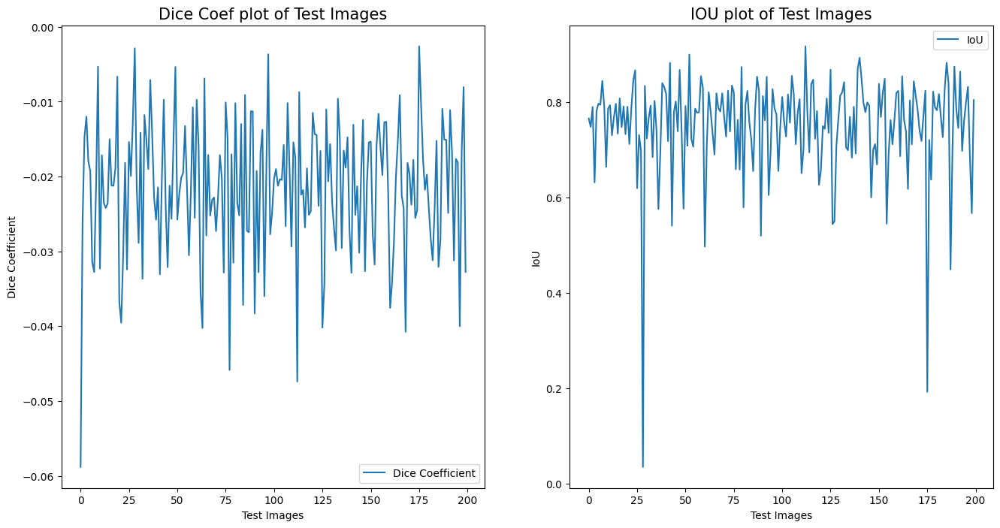

In [ ]:
# Convert lists to numpy arrays for easier analysis
dice_scores = np.array(dice_scores)
iou_scores = np.array(iou_scores)

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(dice_scores, label='Dice Coefficient')
plt.xlabel('Test Images')
plt.ylabel('Dice Coefficient')
plt.title("Dice Coef plot of Test Images", fontsize=15)
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(iou_scores, label='IoU')
plt.xlabel('Test Images')
plt.ylabel('IoU')
plt.title("IOU plot of Test Images", fontsize=15)
plt.legend()

plt.show()

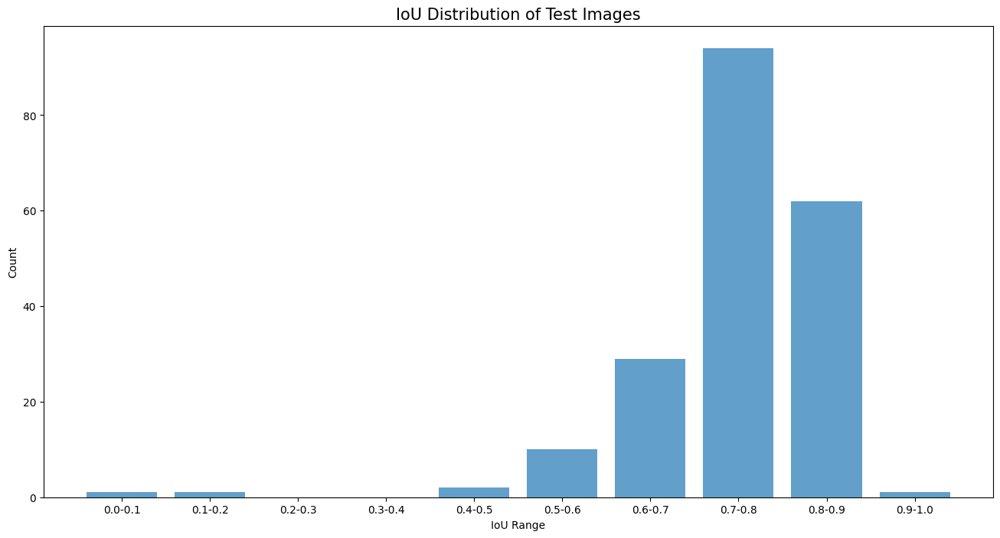

In [ ]:
bins = np.linspace(0,1,11)
iou_bins = np.digitize(iou_scores,bins,right=True)

iou_hist = np.histogram(iou_scores, bins = bins)
# Plotting the IoU distribution
# plt.subplot(1, 2, 2)
plt.figure(figsize=(16, 8))
plt.bar(range(len(bins)-1), iou_hist[0], align='center', alpha=0.7)
plt.xticks(range(len(bins)-1), [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)])
plt.xlabel('IoU Range')
plt.ylabel('Count')
plt.title("IoU Distribution of Test Images", fontsize=15)

plt.show()

### with deep supervision

In [ ]:
import os
save_dir = '/content/drive/My Drive/tifr_notebook/unet++_deep_sup'
os.makedirs(save_dir, exist_ok=True)

In [ ]:
def unet_plus(input=(256,256,3), num_classes=1, deep_supervision = True):
  input_shape= tf.keras.layers.Input(shape=input)

  #encoding
  x_00 = conv_block(input_shape,64)
  x_10 = conv_block(tf.keras.layers.MaxPool2D()(x_00), 128)
  x_20 = conv_block(tf.keras.layers.MaxPool2D()(x_10), 256)
  x_30 = conv_block(tf.keras.layers.MaxPool2D()(x_20), 512)
  x_40 = conv_block(tf.keras.layers.MaxPool2D()(x_30), 1024)

  #skip connection

  x_01 = conv_block(tf.keras.layers.concatenate([x_00, tf.keras.layers.UpSampling2D()(x_10)]), 64)
  x_11 = conv_block(tf.keras.layers.concatenate([x_10, tf.keras.layers.UpSampling2D()(x_20)]), 128)
  x_21 = conv_block(tf.keras.layers.concatenate([x_20, tf.keras.layers.UpSampling2D()(x_30)]), 256)
  x_31 = conv_block(tf.keras.layers.concatenate([x_30, tf.keras.layers.UpSampling2D()(x_40)]), 512)

  x_02 = conv_block(tf.keras.layers.concatenate([
      x_00,x_01,tf.keras.layers.UpSampling2D()(x_11)]), 64)
  x_12 = conv_block(tf.keras.layers.concatenate([x_10,x_11, tf.keras.layers.UpSampling2D()(x_21)]), 128)
  x_22 = conv_block(tf.keras.layers.concatenate([x_20,x_21, tf.keras.layers.UpSampling2D()(x_31)]), 256)

  x_03 = conv_block(tf.keras.layers.concatenate([
      x_00,x_01,x_02, tf.keras.layers.UpSampling2D()(x_12)
  ]), 64)
  x_13 = conv_block(tf.keras.layers.concatenate([
      x_10,x_11,x_12, tf.keras.layers.UpSampling2D()(x_22)
  ]), 128)

  x_04 = conv_block(tf.keras.layers.concatenate([
      x_00,x_01,x_02,x_03,tf.keras.layers.UpSampling2D()(x_13)
  ]),64)





  # Deep supervision outputs
  output_01 = tf.keras.layers.Conv2D(num_classes, (1, 1), name="output_01")(x_01)
  output_02 = tf.keras.layers.Conv2D(num_classes, (1, 1), name="output_02")(x_02)
  output_03 = tf.keras.layers.Conv2D(num_classes, (1, 1), name="output_03")(x_03)
  output_04 = tf.keras.layers.Conv2D(num_classes, (1, 1), name="output_04")(x_04)

  # Final output (always defined)
  output = tf.keras.layers.Conv2D(num_classes, (1, 1), name="final_output")(x_04)

  # if deep_supervision:
  #   output = tf.keras.layers.concatenate([output_01, output_02, output_03, output_04], axis=3)
  #   output = tf.keras.layers.Conv2D(num_classes, (1, 1))(output)
  #   # output = [
  #   #     tf.keras.layers.Conv2D(num_classes,1)(x_01),
  #   #     tf.keras.layers.Conv2D(num_classes,1)(x_02),
  #   #     tf.keras.layers.Conv2D(num_classes,1)(x_03),
  #   #     tf.keras.layers.Conv2D(num_classes,1)(x_04)
  #   # ]

  #   # # print("ouput_shape_123", output[0].shape)
  #   # output = tf.keras.layers.concatenate(output, axis=3)
  #   # output = tf.keras.layers.Conv2D(num_classes, 1)(output)
  #   # print("ouput_shape", output.shape)
  # else:
  #   output = output_04
  #   # output = tf.keras.layers.Conv2D(num_classes,1)(x_04)
  #   # print("ouput_shape", output.shape)

  # model = tf.keras.Model(inputs=input_shape, outputs= output, name = 'unet_plus')
  model = tf.keras.Model(inputs=input_shape, outputs=[output_01, output_02, output_03, output_04, output], name='unet_plus')

  return model



model = unet_plus()
model.summary()


Model: "unet_plus"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 256, 256, 64)         39232     ['input_1[0][0]']             
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['sequential[0][0]']          
 D)                                                                                               
                                                                                                  
 sequential_1 (Sequential)   (None, 128, 128, 128)        222464    ['max_pooling2d[0][0]'

In [ ]:
# Define reducelr function to reduce learning rate
reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                              mode='min',
                              verbose=1,
                              patience=15,
                              min_delta=0.0001,
                              factor=0.2
                             )

# Define the earltstop function
earlystopping = EarlyStopping(monitor='val_loss',
                              min_delta=0.001,
                              mode='min',
                              verbose=1,
                              patience=20,
                              restore_best_weights = True
                             )

# Defining the Callbacks Function
checkpointer2 = [ModelCheckpoint('/content/drive/My Drive/tifr_notebook/unet++_deep_sup.hdf5', verbose=1, save_best_only=True)]
callbacks = [checkpointer2, earlystopping, reduce_lr]

Finding the depth of model with using deep supervison

In [ ]:
# Create the model with deep supervision
model_with_deep_supervision = unet_plus(input=(128, 128, 3), num_classes=1,deep_supervision=True)
print("Number of layers with deep supervision:", len(model_with_deep_supervision.layers))

# Save the model weights
model_with_deep_supervision.save_weights('unet_plus_deep_supervision_weights.h5')

# Create the model without deep supervision
model_without_deep_supervision = unet_plus(input=(128, 128, 3), num_classes=1, deep_supervision=True)
# Load the saved weights into the model
model_without_deep_supervision.load_weights('unet_plus_deep_supervision_weights.h5')

# Create a new model that outputs only the final segmentation map
inference_model = tf.keras.Model(inputs=model_without_deep_supervision.input,
                                 outputs=model_without_deep_supervision.get_layer("final_output").output)

print("Number of layers without deep supervision:", len(inference_model.layers))


Number of layers with deep supervision: 45
Number of layers without deep supervision: 41


In [ ]:
model = unet_plus(input=(im_height, im_width, 3),num_classes=1, deep_supervision=True)
print(BATCH_SIZE)
model.compile(optimizer='adam',
              loss={'output_01': combined_loss, 'output_02': combined_loss, 'output_03': combined_loss, 'output_04': combined_loss, 'final_output': combined_loss},
              metrics=[custom_binary_accuracy, iou, dice_coef])

history = model.fit(train_gen,
                    steps_per_epoch = len(train) / BATCH_SIZE,
                    epochs=EPOCHS,
                    validation_data = test_gen,
                    validation_steps = len(val) / BATCH_SIZE,
                    callbacks = callbacks)

32
Found 1440 validated image filenames.
Found 1440 validated image filenames.
Epoch 1/30
45/45 [==============================] - ETA: 0s - loss: 2.7214 - output_01_loss: 0.4919 - output_02_loss: 0.6134 - output_03_loss: 0.5355 - output_04_loss: 0.5489 - final_output_loss: 0.5316 - output_01_custom_binary_accuracy: 0.9829 - output_01_iou: -0.0092 - output_01_dice_coef: 0.1601 - output_02_custom_binary_accuracy: 0.9611 - output_02_iou: -0.0339 - output_02_dice_coef: 0.0762 - output_03_custom_binary_accuracy: 0.9757 - output_03_iou: -0.1235 - output_03_dice_coef: 0.1249 - output_04_custom_binary_accuracy: 0.9805 - output_04_iou: -0.0265 - output_04_dice_coef: 0.1083 - final_output_custom_binary_accuracy: 0.9846 - final_output_iou: -0.0153 - final_output_dice_coef: 0.1127Found 360 validated image filenames.
Found 360 validated image filenames.

Epoch 1: val_loss improved from inf to 23.73359, saving model to /content/drive/My Drive/tifr_notebook/unet++_deep_sup.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


45/45 [==============================] - 86s 1s/step - loss: 2.7214 - output_01_loss: 0.4919 - output_02_loss: 0.6134 - output_03_loss: 0.5355 - output_04_loss: 0.5489 - final_output_loss: 0.5316 - output_01_custom_binary_accuracy: 0.9829 - output_01_iou: -0.0092 - output_01_dice_coef: 0.1601 - output_02_custom_binary_accuracy: 0.9611 - output_02_iou: -0.0339 - output_02_dice_coef: 0.0762 - output_03_custom_binary_accuracy: 0.9757 - output_03_iou: -0.1235 - output_03_dice_coef: 0.1249 - output_04_custom_binary_accuracy: 0.9805 - output_04_iou: -0.0265 - output_04_dice_coef: 0.1083 - final_output_custom_binary_accuracy: 0.9846 - final_output_iou: -0.0153 - final_output_dice_coef: 0.1127 - val_loss: 23.7336 - val_output_01_loss: 0.6292 - val_output_02_loss: 0.7468 - val_output_03_loss: 3.9397 - val_output_04_loss: 9.7843 - val_final_output_loss: 8.6336 - val_output_01_custom_binary_accuracy: 0.9892 - val_output_01_iou: 0.0135 - val_output_01_dice_coef: 0.0158 - val_output_02_custom_binar

In [ ]:
import pickle

# Save the history as a pickle file in the specified directory
with open(save_dir + '/history_adam.pkl', 'wb') as f:
    pickle.dump(history, f)

In [ ]:
np.save(f"{save_dir}/history_adam_dir.npy", history)

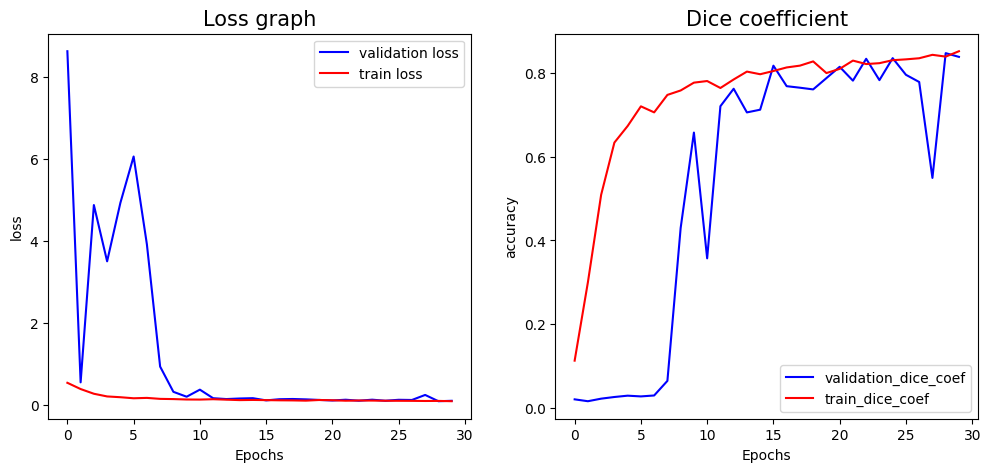

In [ ]:
import matplotlib.pyplot as plt

# history = history.history

list_traindice = history['final_output_dice_coef']
list_valdice = history['val_final_output_dice_coef']

list_trainjaccard = history['final_output_iou']
list_valjaccard = history['val_final_output_iou']

list_trainloss = history['final_output_loss']
list_valloss = history['val_final_output_loss']

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(list_valloss, 'b-', label='validation loss')
plt.plot(list_trainloss,'r-', label='train loss')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title('Loss graph', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(list_valdice, 'b-', label= 'validation_dice_coef')
plt.plot(list_traindice, 'r-', label= 'train_dice_coef')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('Dice coefficient', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
# plt.show()

plot_filename = os.path.join(save_dir, f'Dice coefficient Loss graph.png')
plt.savefig(plot_filename)
plt.show()



In [ ]:
from tensorflow.keras.models import Model, load_model

# Creating the model (same architecture, but we will use only the final output)
model = unet_plus(input=(im_height, im_width, 3), num_classes=1)

model.load_weights('/content/drive/My Drive/tifr_notebook/unet++_deep_sup.hdf5')

# Creating a new model that outputs only the final segmentation map
inference_model = tf.keras.Model(inputs=model.input, outputs=model.get_layer("final_output").output)

# Compiling the inference model (loss is not needed for inference)
inference_model.compile(optimizer='adam', loss=combined_loss, metrics=[custom_binary_accuracy, iou, dice_coef])


In [ ]:
test_gen = train_generator(test,
                           1,
                           dict(),
                           target_size=(im_height, im_width))

results = inference_model.evaluate(test_gen,
                         steps=len(test) / BATCH_SIZE)

print("Test lost: ",results[0])
print("Test IOU: ",results[1])
print("Test Dice Coefficent: ",results[2])

np.save(f"{save_dir}/test_results_unet_adam", results)

Found 200 validated image filenames.
Found 200 validated image filenames.
6/6 [==============================] - 16s 2s/step - loss: 0.1199 - custom_binary_accuracy: 0.9948 - iou: 0.0027 - dice_coef: 0.7981
Test lost:  0.11988218873739243
Test IOU:  0.9947596788406372
Test Dice Coefficent:  0.002666990039870143


1/1 [==============================] - 4s 4s/step


dice_score -0.009697866
mask_shape (1, 128, 128, 1) pred_shape (128, 128)
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(0.0, shape=(), dtype=float32)
Image 3: Dice Coefficient = -0.009697865694761276, IoU = 0.0


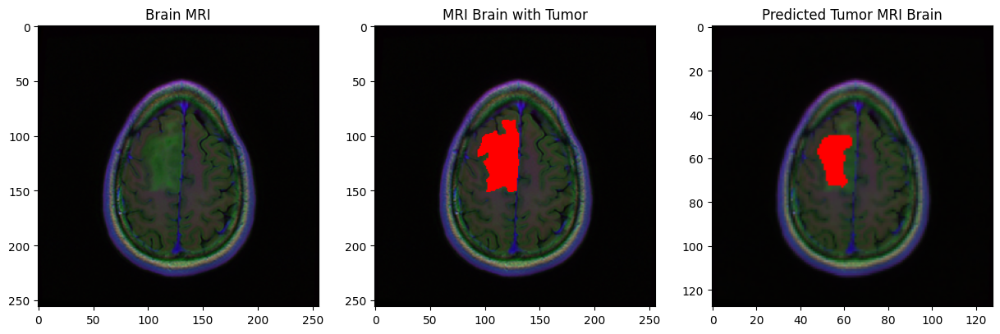

1/1 [==============================] - 1s 1s/step


dice_score -0.009710294
mask_shape (1, 128, 128, 1) pred_shape (128, 128)
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(nan, shape=(), dtype=float32)
Image 5: Dice Coefficient = -0.00971029419451952, IoU = nan


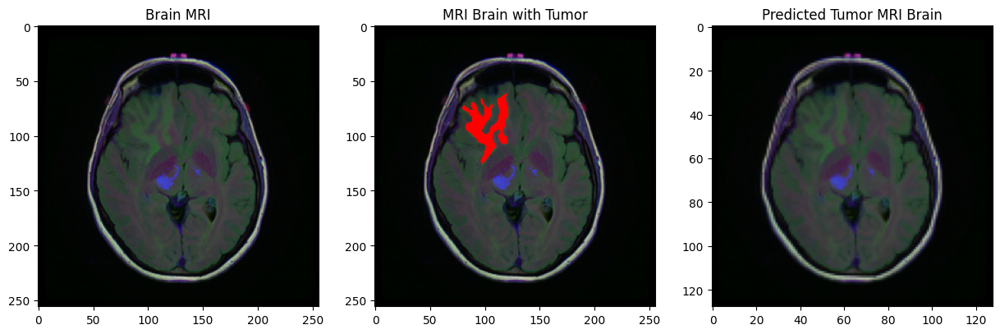

1/1 [==============================] - 1s 1s/step


dice_score -0.009679701
mask_shape (1, 128, 128, 1) pred_shape (128, 128)
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(0.0, shape=(), dtype=float32)
Image 7: Dice Coefficient = -0.009679701179265976, IoU = 0.0


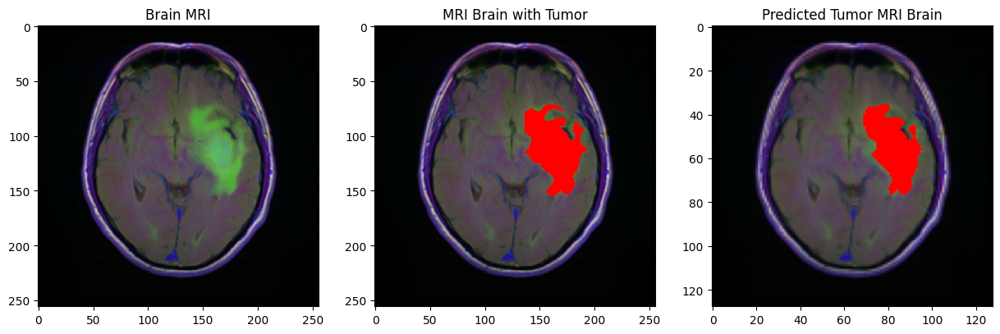

1/1 [==============================] - 1s 1s/step


dice_score -0.009704992
mask_shape (1, 128, 128, 1) pred_shape (128, 128)
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(0.0, shape=(), dtype=float32)
Image 27: Dice Coefficient = -0.009704992175102234, IoU = 0.0


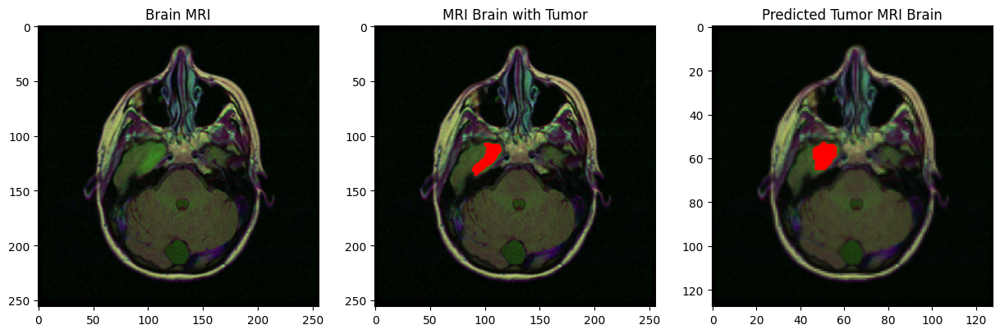

1/1 [==============================] - 2s 2s/step


dice_score -0.009670793
mask_shape (1, 128, 128, 1) pred_shape (128, 128)
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(0.0, shape=(), dtype=float32)
Image 33: Dice Coefficient = -0.009670793078839779, IoU = 0.0


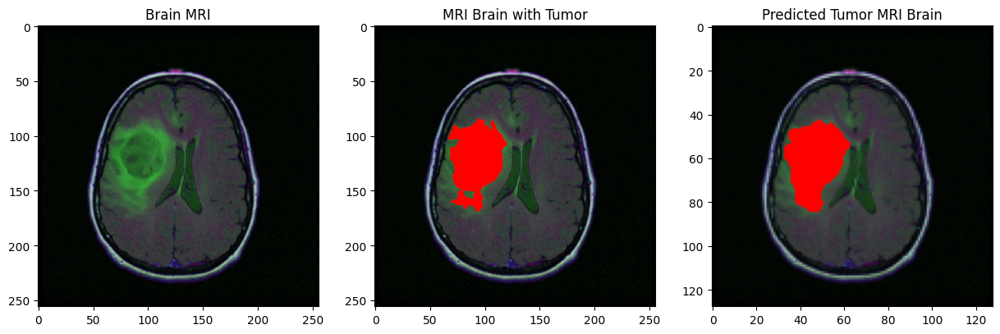

1/1 [==============================] - 1s 1s/step


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

for i in range(1, 40, 2):
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)

    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img1 = img.copy()
    img1 = cv2.resize(img1, (256, 256))
    img1 = img1 / 255.0
    img1_for_plotting = img1.copy()

    img = cv2.resize(img, (im_height, im_width))

    img = img / 255.0

    img = img[np.newaxis, :, :, :]


    msk = cv2.imread(msk_path_test, cv2.IMREAD_GRAYSCALE)

    # Predictions
    img1=img
    pred = model.predict(img)
    img = np.squeeze(img)

    # if mask is non empty
    if np.any(msk):

      # Plot the Brain MRI scans
      original = img1_for_plotting.copy()
      fig, ax = plt.subplots(1, 3, figsize=(15, 5))
      ax[0].imshow(original)
      ax[0].set_title("Brain MRI")

      # Plot the Brain MRI scan with their mask
      main = original.copy()
      contours, hier = cv2.findContours(msk, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
      sample_over_gt = cv2.drawContours(main, contours, -1, [255, 0, 0], thickness=-1)
      ax[1].imshow(np.squeeze(sample_over_gt))
      ax[1].set_title("MRI Brain with Tumor")

      # Plot the predicted mask on the Brain MRI Scan
      main = img.copy()
      avg_pred = np.mean(pred, axis=0)
      pred_mask = np.squeeze(avg_pred)  # Remove batch dimension from prediction
      pred_binary = (pred_mask > 0.5).astype(np.float32)  # Convert to binary mask

      # Calculate Dice and IoU scores
      dice_score = dice_coef_loss(mask,pred_binary).numpy()
      print("dice_score", dice_score)
      print("mask_shape",mask.shape,"pred_shape",pred_binary.shape)
      iou_score = iou(mask, pred_binary).numpy()

      # Optionally print the scores for each image
      print(f"Image {i}: Dice Coefficient = {dice_score}, IoU = {iou_score}")
      sample = (np.squeeze(avg_pred) > 0.5).astype(np.uint8) * 255  # Ensure it's a binary mask
      contours, hier = cv2.findContours(sample, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
      sample_over_pr = cv2.drawContours(main, contours, -1, [255, 0, 0], thickness=-1)
      ax[2].imshow(np.squeeze(sample_over_pr))
      ax[2].set_title("Predicted Tumor MRI Brain")

      plt.show()


1/1 [==============================] - 1s 1s/step


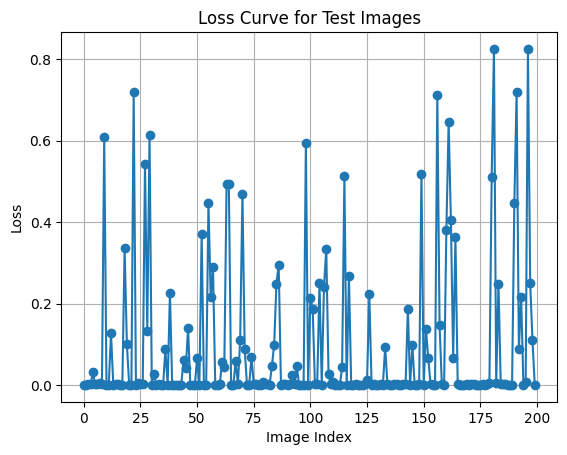

In [ ]:
import matplotlib.pyplot as plt

# Initialize lists to store loss values and image indices
loss_values = []
image_indices = []

# Iterate through the test images
for i in range(min(len(test),30000)):
    image, mask = next(test_gen)

    # Obtain the prediction from the model
    prediction = model.predict(image)

    # Calculate the loss between the predicted mask and the ground truth mask
    loss_tensor = combined_loss(mask, prediction[-1])
    loss = tf.reduce_mean(loss_tensor).numpy()
     # You need to define this function
    # print(loss)

    # Append the loss value and image index to the lists
    loss_values.append(loss)
    image_indices.append(i)


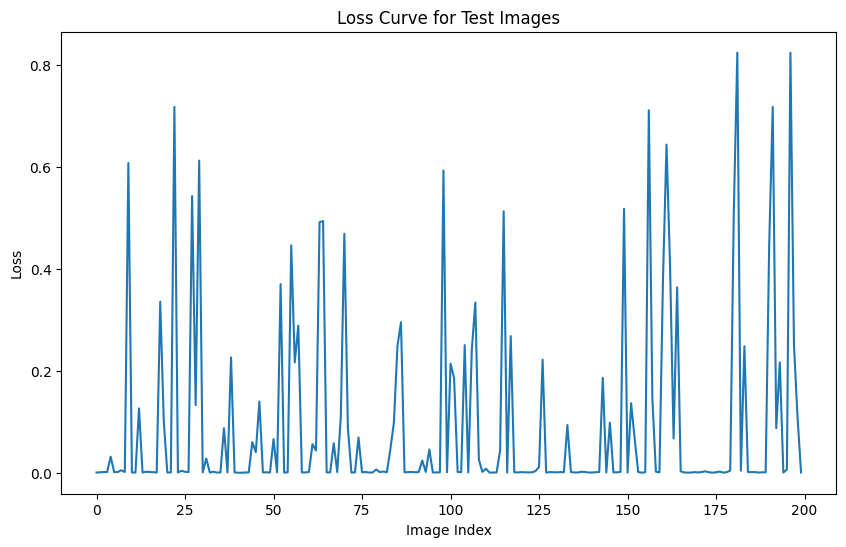

<Figure size 640x480 with 0 Axes>

In [ ]:
# plt.subplot(1,4,4)
plt.figure(figsize=(10, 6))
plt.plot(image_indices, loss_values)
plt.xlabel('Image Index')
plt.ylabel('Loss')
plt.title('Loss Curve for Test Images')
# plt.grid(True)
plt.show()
plot_filename = os.path.join(save_dir, f'Loss Curve for Test Images')
plt.savefig(plot_filename)
plt.show()


In [ ]:
# Lists to store Dice and IoU scores
dice_scores = []
iou_scores = []

# Assuming test is a pandas DataFrame with paths to test images and masks
for i in range(len(test)):
    image, mask = next(test_gen)

    # Predictions
    preds = model.predict(image)

    # Average the predictions (for deep supervision)
    avg_pred = np.mean(preds, axis=0)

    # Squeeze and process the average prediction
    pred_mask = np.squeeze(avg_pred)  # Remove batch dimension from prediction
    pred_binary = (pred_mask > 0.5).astype(np.float32)  # Convert to binary mask


    dice_score = dice_coef_loss(mask,pred_binary).numpy()
    iou_score = iou(mask, pred_binary).numpy()

    # Append scores to lists
    dice_scores.append(dice_score)
    iou_scores.append(iou_score)

    # Optionally print the scores for each image
    print(f"Image {i}: Dice Coefficient = {dice_score}, IoU = {iou_score}")



1/1 [==============================] - 2s 2s/step
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(1.0, shape=(), dtype=float32)
Image 0: Dice Coefficient = -0.00971029419451952, IoU = 1.0
1/1 [==============================] - 3s 3s/step
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(1.0, shape=(), dtype=float32)
Image 1: Dice Coefficient = -0.00971029419451952, IoU = 1.0
1/1 [==============================] - 2s 2s/step
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(1.0, shape=(), dtype=float32)
Image 2: Dice Coefficient = -0.00971029419451952, IoU = 1.0
1/1 [==============================] - 1s 1s/step
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(1.0, shape=(), dtype=float32)
Image 3: Dice Coefficient = -0.00971029419451952, IoU = 1.0
1/1 [==============================] - 1s 1s/step
shapes (1, 128, 128, 1) true (1, 128, 128, 1)
iou_score tf.Tensor(1.0, shape=(), dtype=float32)
Image 4: Dice Coefficient = -0

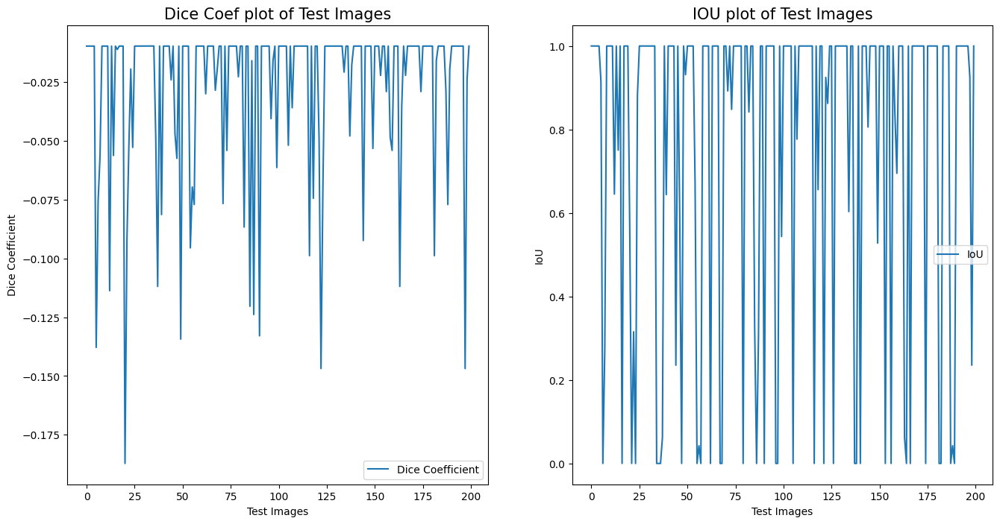

In [ ]:
# Convert lists to numpy arrays for easier analysis
dice_scores = np.array(dice_scores)
iou_scores = np.array(iou_scores)

# Optionally, plot the metrics
plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(dice_scores, label='Dice Coefficient')
plt.xlabel('Test Images')
plt.ylabel('Dice Coefficient')
plt.title("Dice Coef plot of Test Images", fontsize=15)
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(iou_scores, label='IoU')
plt.xlabel('Test Images')
plt.ylabel('IoU')
plt.title("IOU plot of Test Images", fontsize=15)
plt.legend()

plt.show()

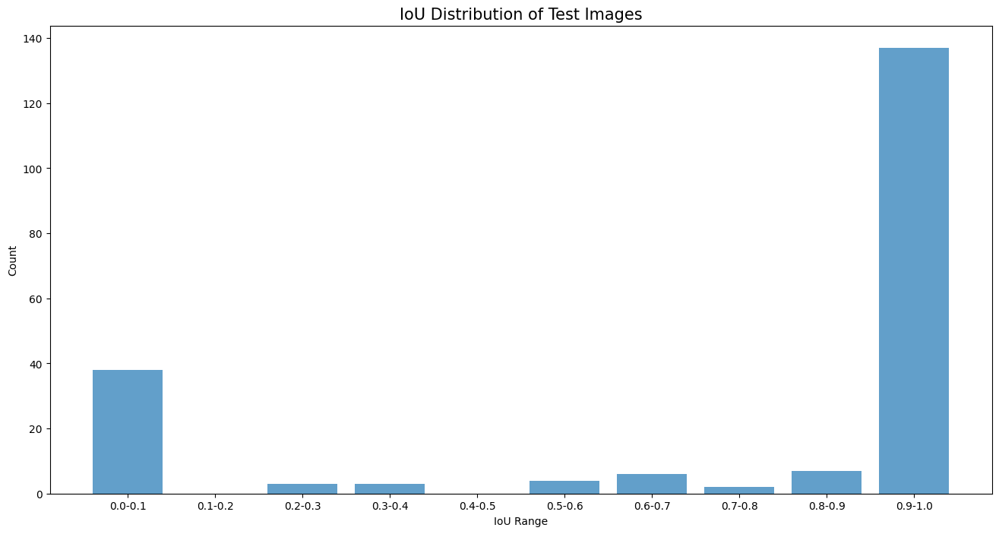

In [ ]:
bins = np.linspace(0,1,11)
iou_bins = np.digitize(iou_scores,bins,right=True)

iou_hist = np.histogram(iou_scores, bins = bins)
# Plotting the IoU distribution
# plt.subplot(1, 2, 2)
plt.figure(figsize=(16, 8))
plt.bar(range(len(bins)-1), iou_hist[0], align='center', alpha=0.7)
plt.xticks(range(len(bins)-1), [f"{bins[i]:.1f}-{bins[i+1]:.1f}" for i in range(len(bins)-1)])
plt.xlabel('IoU Range')
plt.ylabel('Count')
plt.title("IoU Distribution of Test Images", fontsize=15)

plt.show()

# Extra Code

1/1 [==============================] - 1s 1s/step
mask_ [0. 1.]
Mask shape: (1, 128)
Mask dtype: uint8


error: OpenCV(4.8.0) /io/opencv/modules/imgproc/src/contours.cpp:195: error: (-210:Unsupported format or combination of formats) [Start]FindContours supports only CV_8UC1 images when mode != CV_RETR_FLOODFILL otherwise supports CV_32SC1 images only in function 'cvStartFindContours_Impl'


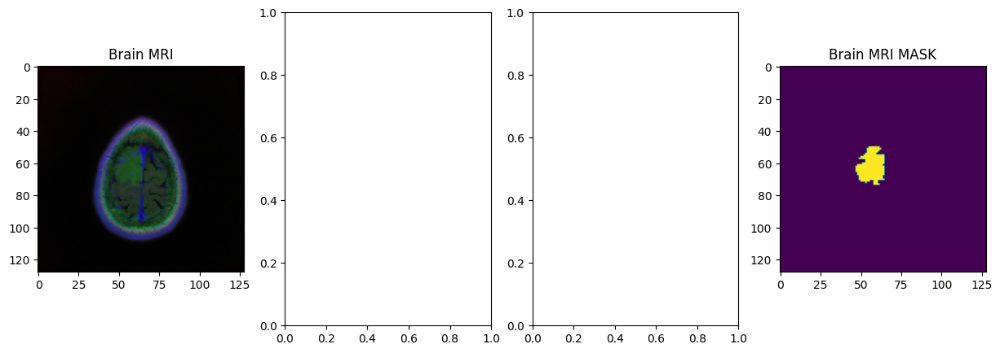

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt


for i in range(1, 50, 2):
    #
    img, msk = next(test_gen)
    # img = cv2.imread(img_path_test)
    # print(img.shape)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # # print(img.shape)

    # img1 = img.copy()
    # img1 = cv2.resize(img1, (256, 256))
    # img1 = img1 / 255.0
    # img1_for_plotting = img1.copy()

    # img = cv2.resize(img, (im_height, im_width))
    # # print(img.shape)
    # img = img / 255.0
    # # print(img.shape)
    # img = img[np.newaxis, :, :, :]
    # # print(img.shape)

    # msk = cv2.imread(msk_path_test, cv2.IMREAD_GRAYSCALE)
    # msk = msk / 255.0
    # # Predictions
    img1=img
    pred = model.predict(img)

    # print(pred)

    img = np.squeeze(img)
    # print(img.shape)
    if np.any(msk):
      # Plot the Brain MRI scans
      original = img.copy()
      # print("shape",original.shape,"img",img1.shape)
      fig, ax = plt.subplots(1, 4, figsize=(15, 5))
      # print("shape",original.shape)

      ax[0].imshow(original)
      ax[0].set_title("Brain MRI")


      ax[3].imshow(np.squeeze(msk))
      ax[3].set_title("Brain MRI MASK")
      # Plot the Brain MRI scan with their mask
      main = original.copy()
      print("mask_",np.unique(msk))
      mask = (msk * 255).astype(np.uint8)
      _, msk_binary = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)

      print("Mask shape:", msk_binary.shape)
      print("Mask dtype:", msk_binary.dtype)
      contours, hier = cv2.findContours(np.squeeze(msk), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)

      main_rgb = cv2.cvtColor(main, cv2.COLOR_BGR2RGB)
      sample_over_gt = cv2.drawContours(main_rgb.copy(), contours, -1, [255, 0, 0], thickness=-1)
      # ax[1].imshow(np.squeeze(sample_over_gt))
      ax[1].imshow(main_rgb)
      ax[1].set_title("MRI Brain with Tumor")

      # Plot the predicted mask on the Brain MRI Scan
      main = img.copy()
      # print(len(pred))
      # print(pred[0].shape)
      avg_pred = np.mean(pred, axis=0)
      pred_mask = np.squeeze(avg_pred)  # Remove batch dimension from prediction
      pred_binary = (pred_mask > 0.5).astype(np.float32)  # Convert to binary mask

      # Calculate Dice and IoU scores
      print("binary", np.unique(pred_binary), np.unique(msk))
      dice_score = dice_coef_loss(msk,pred_binary).numpy()
      print("dice_score", dice_score)
      print("mask_shape",mask.shape,"pred_shape",pred_binary.shape)
      iou_score = iou(msk, pred_binary).numpy()

      # Append scores to lists
      # dice_scores.append(dice_score)
      # iou_scores.append(iou_score)

      # Optionally print the scores for each image
      print(f"Image {i}: Dice Coefficient = {dice_score}, IoU = {iou_score}")
      sample = (np.squeeze(avg_pred) > 0.5).astype(np.uint8) * 255  # Ensure it's a binary mask
      contours, hier = cv2.findContours(sample, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
      sample_over_pr = cv2.drawContours(main, contours, -1, [255, 0, 0], thickness=-1)
      ax[2].imshow(np.squeeze(sample_over_pr))
      ax[2].set_title("Predicted Tumor MRI Brain")

      plt.show()


In [ ]:
# for i in range(1,40,2):
#     img_path_test = test.iloc[i, 0]
#     msk_path_test = test.iloc[i, 1]
#     img = cv2.imread(img_path_test)
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
#     img = cv2.resize(img ,(im_height, im_width))
#     img = img / 255
#     img = img[np.newaxis, :, :, :]
#     msk= cv2.imread(msk_path_test)
#     pred = model.predict(img) #predictions
#     img = np.squeeze(img)

#     #Plot the Brain MRI scans
#     original = img.copy()
#     fig, ax = plt.subplots(1,3, figsize = (15,5))
#     ax[0].imshow(original)
#     ax[0].set_title("Brain MRI")

#     # Plot the Brain MRI scan with their mask
#     main = original.copy()
#     label = cv2.imread(msk_path_test)
#     sample = np.array(np.squeeze(label), dtype = np.uint8)
#     contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
#     sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
#     ax[1].imshow(np.squeeze(sample_over_gt))
#     ax[1].set_title("MRI Brain with Tumor")

#     #Plot the predicted mask on the Brain MRI Scan
#     main = original.copy()
#     sample = np.array(np.squeeze(pred) > 0.5, dtype = np.uint8)
#     contours, hier = cv2.findContours(sample,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
#     sample_over_pr = cv2.drawContours(main, contours, -1, [255,0,0], thickness=-1)
#     ax[2].imshow(np.squeeze(sample_over_pr))
#     ax[2].set_title("Predicted Tumor MRI Brain")

1/1 [==============================] - 3s 3s/step


TypeError: Invalid shape (5, 128, 128) for image data

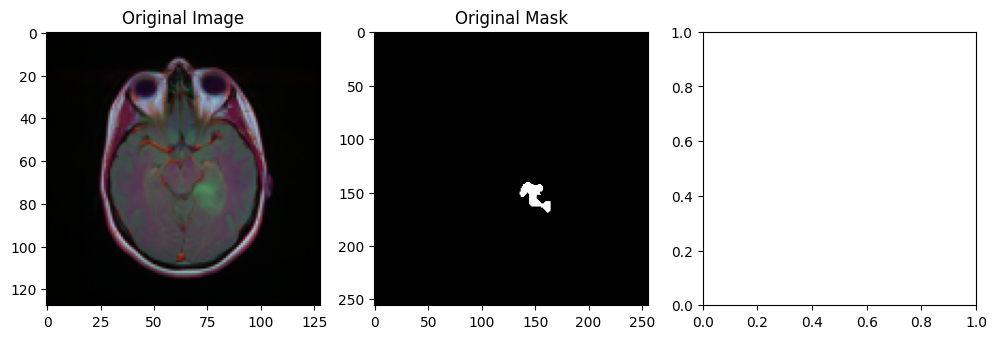

In [ ]:
for i in range(30):
    # index=np.random.randint(1,len(df_test.index))
    # img = cv2.imread(df_test['filename'].iloc[index])
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)
    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    pred=model.predict(img)
    # print(pred)

    plt.figure(figsize=(12,12))
    plt.subplot(1,3,1)
    plt.imshow(np.squeeze(img))
    plt.title('Original Image')
    plt.subplot(1,3,2)
    plt.imshow(np.squeeze(cv2.imread(msk_path_test)))
    plt.title('Original Mask')
    plt.subplot(1,3,3)
    plt.imshow(np.squeeze(pred) > .5)
    plt.title('Prediction')
    plt.show()

1/1 [==============================] - 1s 1s/step


error: OpenCV(4.8.0) /io/opencv/modules/imgproc/src/contours.cpp:195: error: (-210:Unsupported format or combination of formats) [Start]FindContours supports only CV_8UC1 images when mode != CV_RETR_FLOODFILL otherwise supports CV_32SC1 images only in function 'cvStartFindContours_Impl'


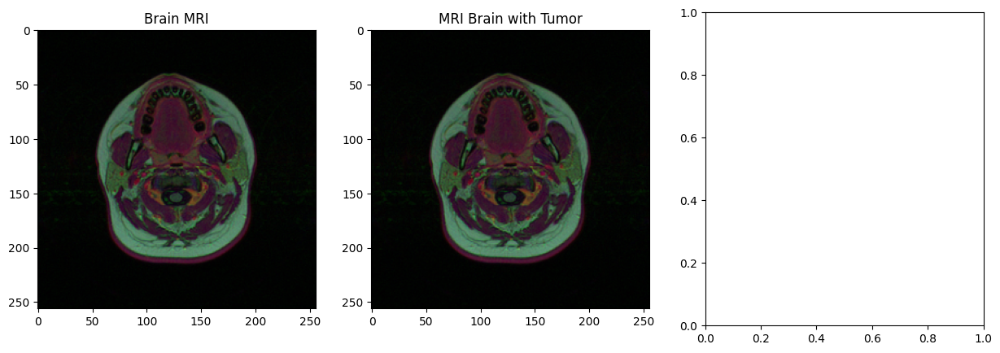

In [ ]:
import matplotlib.pyplot as plt
import cv2

for i in range(1,10,2):
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)
    img1 = img
    # print(img.shape)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255.0
    # img = np.expand_dims(img, axis=0)

    img = img[np.newaxis, :, :, :]
    # msk= cv2.imread(msk_path_test)
    # msk = cv2.cvtColor(msk, cv2.IMREAD_GRAYSCALE)
    # msk = cv2.resize(msk, (im_height, im_width))
    # msk = msk / 255.0
    # # msk = msk[np.newaxis, :, :]
    # msk = np.where(msk > 0.5, 1.0, 0.0)
    pred = model.predict(img) #predictions
    img = np.squeeze(img)

    #Plot the Brain MRI scans
    original = img1.copy()
    fig, ax = plt.subplots(1,3, figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")


    #  # Plot the corresponding mask
    # main = original.copy()
    # mask = msk.copy()
    # ax[1].imshow(mask)
    # ax[1].set_title("Tumor Location")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path_test)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    # ax[2].imshow(np.squeeze(sample_over_gt))
    ax[1].imshow(sample_over_gt)
    ax[1].set_title("MRI Brain with Tumor")

    #Plot the predicted mask on the Brain MRI Scan
    main = img.copy()
    sample = np.array(np.squeeze(pred) > 0.5, dtype = np.uint8)
    contours, hier = cv2.findContours(sample,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_pr = cv2.drawContours(main, contours, -1, [255,0,0], thickness=-1)
    ax[2].imshow(np.squeeze(sample_over_pr))
    ax[2].set_title("Predicted Tumor MRI Brain")


    # plot_filename = os.path.join(save_dir, f'Dice coefficient Loss graph.png')
    # plt.savefig(plot_filename)
    # plt.show()

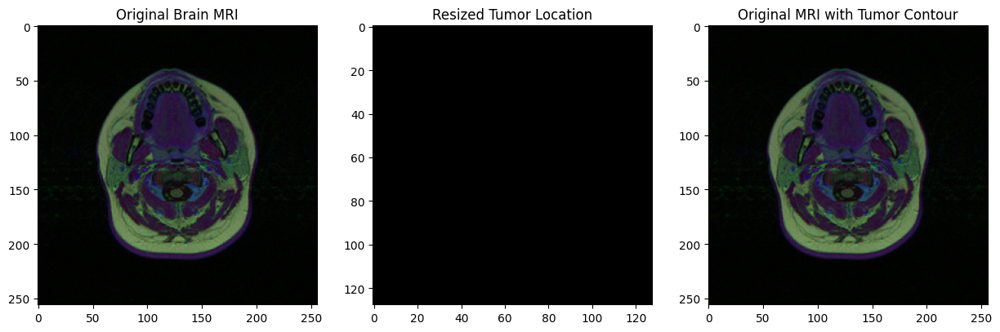

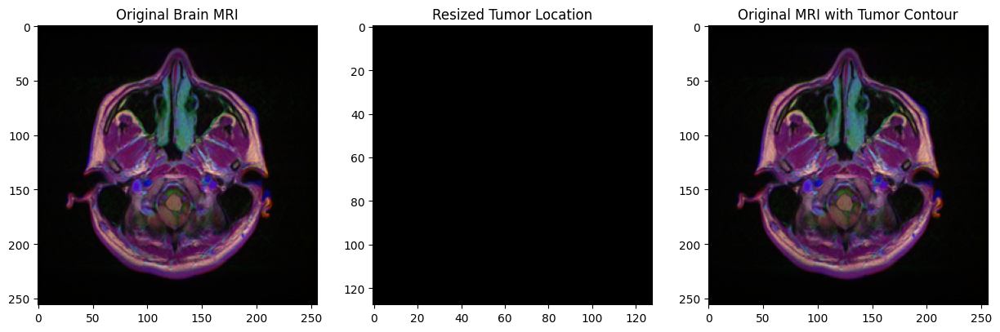

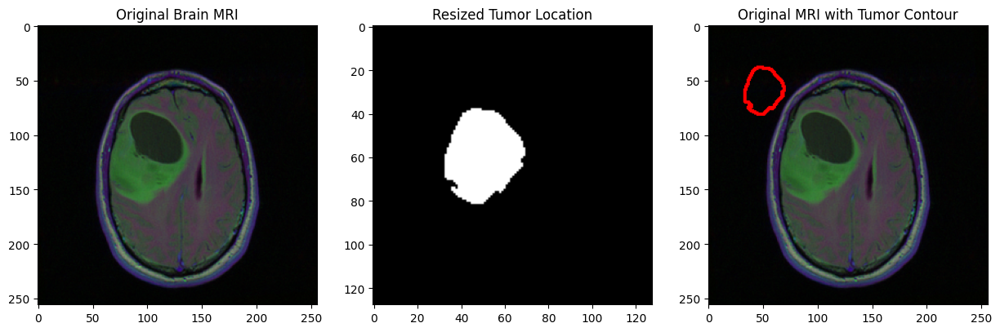

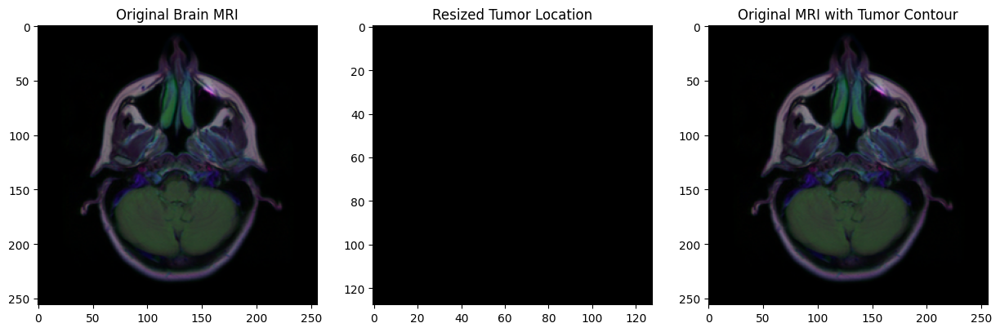

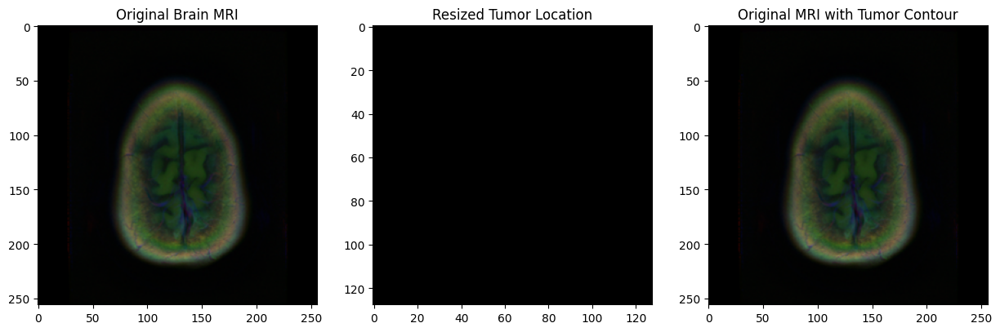

In [ ]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

for i in range(1, 10, 2):
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]

    # Read the original image and mask
    img = cv2.imread(img_path_test)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    msk = cv2.imread(msk_path_test, cv2.IMREAD_GRAYSCALE)

    # Resize image and mask to the same size as used in training
    img_resized = cv2.resize(img_rgb, (im_height, im_width))
    msk_resized = cv2.resize(msk, (im_height, im_width))

    # Normalize image and mask
    img_resized = img_resized / 255.0
    msk_resized = msk_resized / 255.0

    # Expand dimensions to match model input
    img_resized = np.expand_dims(img_resized, axis=0)

    # Ensure mask is binary
    msk_resized = np.where(msk_resized > 0.5, 1.0, 0.0)

    # Plot the original image
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(img_rgb)
    ax[0].set_title("Original Brain MRI")

    # Plot the resized mask
    ax[1].imshow(msk_resized, cmap='gray')
    ax[1].set_title("Resized Tumor Location")

    # Overlay the mask on the original image
    overlay = img_rgb.copy()
    contours, _ = cv2.findContours(msk_resized.astype(np.uint8), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    overlay = cv2.drawContours(overlay, contours, -1, (255, 0, 0), thickness=2)
    ax[2].imshow(overlay)
    ax[2].set_title("Original MRI with Tumor Contour")

    plt.show()


### others

In [ ]:
for i in range(1,40,2):
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    msk= cv2.imread(msk_path_test)
    pred = model.predict(img) #predictions
    img = np.squeeze(img)

    #Plot the Brain MRI scans
    original = img.copy()
    fig, ax = plt.subplots(1,3, figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path_test)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    ax[1].imshow(np.squeeze(sample_over_gt))
    ax[1].set_title("MRI Brain with Tumor")

    #Plot the predicted mask on the Brain MRI Scan
    main = original.copy()
    sample = np.array(np.squeeze(pred) > 0.5, dtype = np.uint8)
    contours, hier = cv2.findContours(sample,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_pr = cv2.drawContours(main, contours, -1, [255,0,0], thickness=-1)
    ax[2].imshow(np.squeeze(sample_over_pr))
    ax[2].set_title("Predicted Tumor MRI Brain")

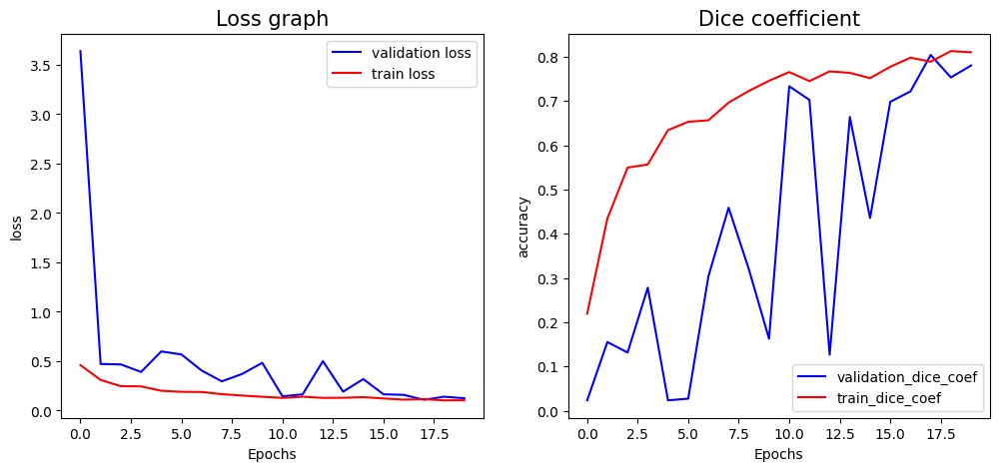

In [ ]:
import matplotlib.pyplot as plt

history = history.history

list_traindice = history['dice_coef']
list_valdice = history['val_dice_coef']

list_trainjaccard = history['iou']
list_valjaccard = history['val_iou']

list_trainloss = history['loss']
list_valloss = history['val_loss']

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(list_valloss, 'b-', label='validation loss')
plt.plot(list_trainloss,'r-', label='train loss')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title('Loss graph', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(list_valdice, 'b-', label= 'validation_dice_coef')
plt.plot(list_traindice, 'r-', label= 'train_dice_coef')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('Dice coefficient', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
plt.show()




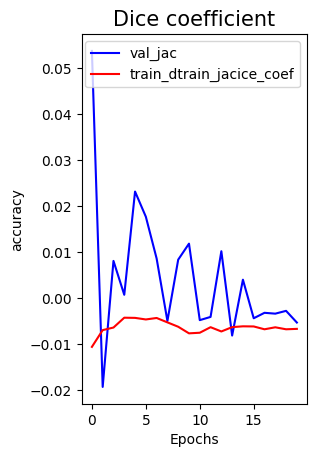

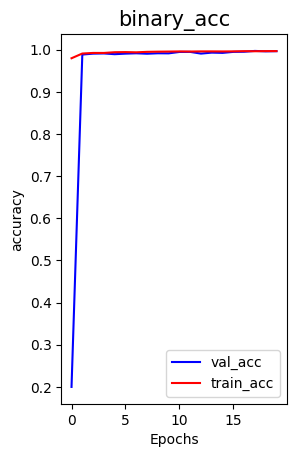

In [ ]:
plt.subplot(1,2,2)
plt.plot(list_valjaccard, 'b-', label= 'val_jac')
plt.plot(list_trainjaccard, 'r-', label= 'train_dtrain_jacice_coef')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('Dice coefficient', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
plt.show()


train_binary_acc = history['custom_binary_accuracy']
val_binary_acc = history['val_custom_binary_accuracy']
plt.subplot(1,2,2)
plt.plot(val_binary_acc, 'b-', label= 'val_acc')
plt.plot(train_binary_acc, 'r-', label= 'train_acc')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('binary_acc', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
plt.show()


In [ ]:
from tensorflow.keras.models import Model, load_model, save_model
model = unet_plus(input=(im_height, im_width, 3),num_classes=1, deep_supervision=False)
model.load_weights('unet++_brain_mri_seg.hdf5')
# , custom_objects={'dice_coef_loss': dice_coef_loss, 'iou': iou, 'dice_coef': dice_coef})
model.compile(optimizer='adam', loss=combined_loss, metrics=[custom_binary_accuracy, iou, dice_coef])

ValueError: Layer count mismatch when loading weights from file. Model expected 16 layers, found 20 saved layers.

In [ ]:
test_gen = train_generator(test,
                           BATCH_SIZE,
                           dict(),
                           target_size=(im_height, im_width))

results = model.evaluate(test_gen,
                         steps=len(test) / BATCH_SIZE)

print("Test lost: ",results[0])
print("Test IOU: ",results[1])
print("Test Dice Coefficent: ",results[2])

Found 200 validated image filenames.
Found 200 validated image filenames.
6/6 [==============================] - 4s 378ms/step - loss: 0.1425 - custom_binary_accuracy: 0.9960 - iou: -0.0029 - dice_coef: 0.7627
Test lost:  0.1425015777349472
Test IOU:  0.9959959387779236
Test Dice Coefficent:  -0.0028712772764265537


1/1 [==============================] - 0s 159ms/step


1/1 [==============================] - 0s 35ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step


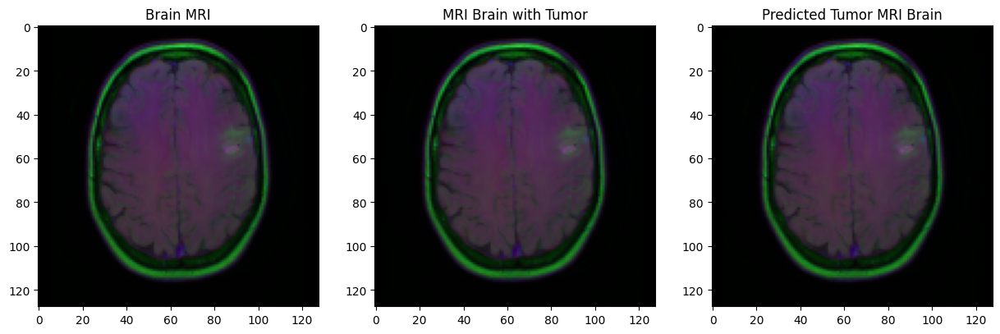

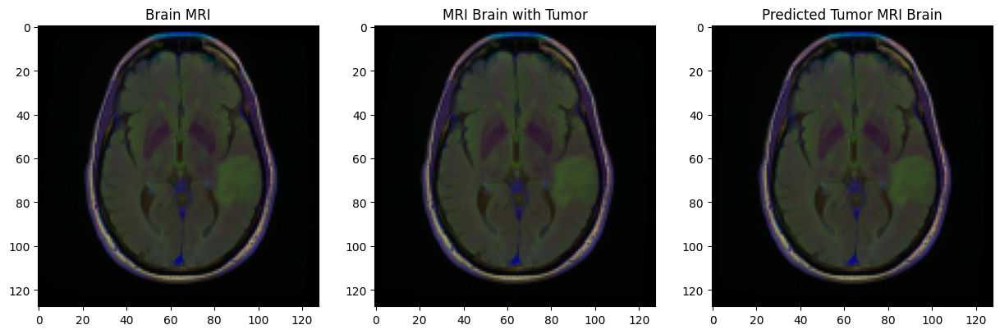

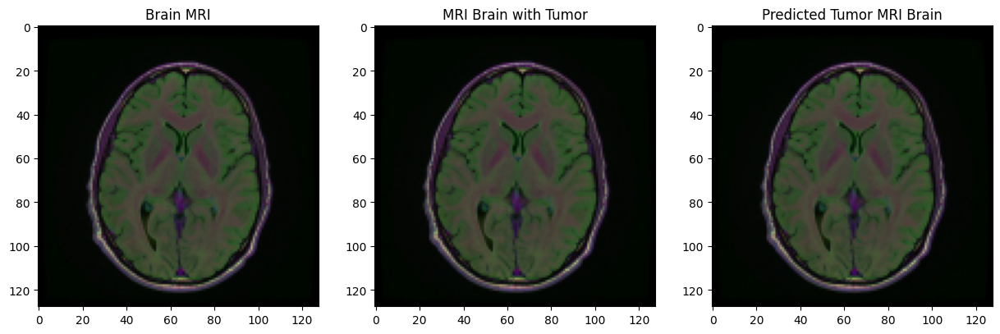

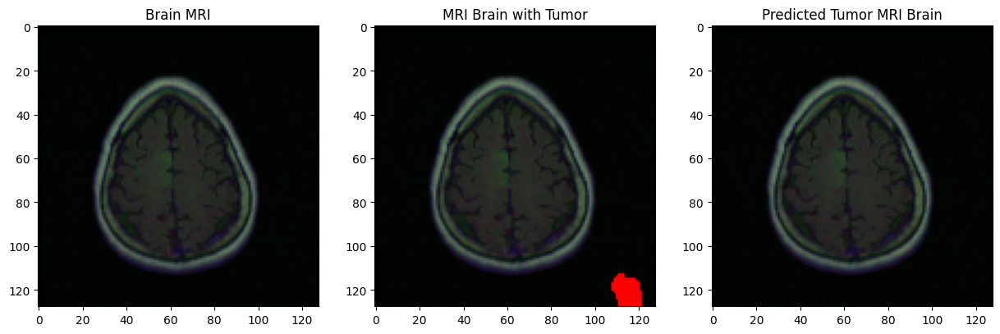

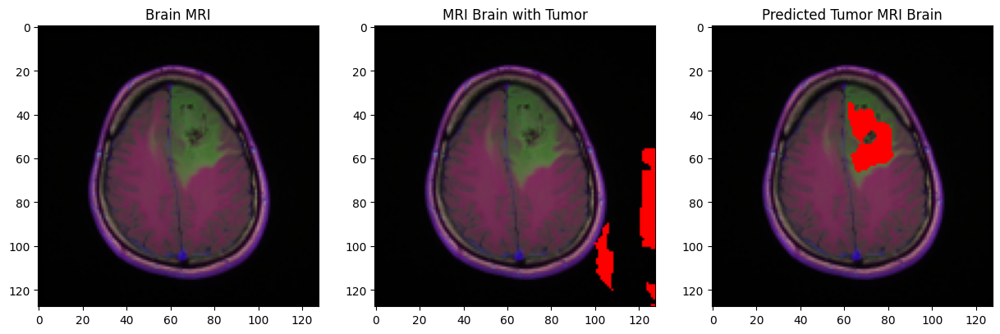

...

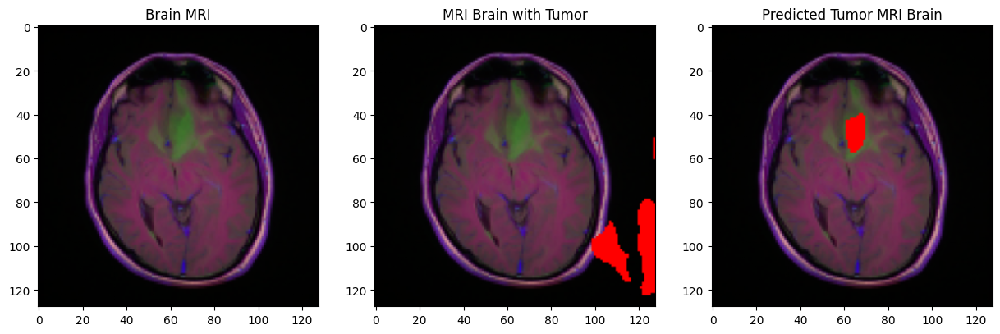

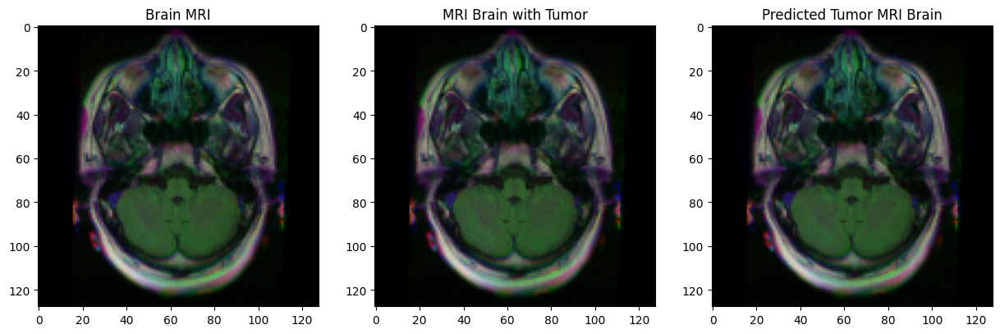

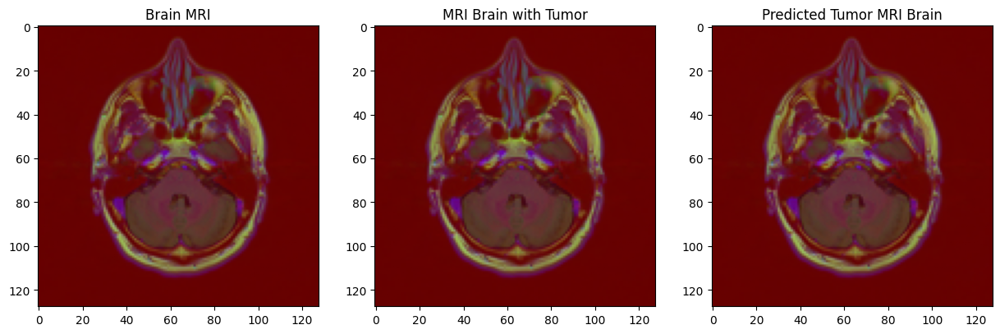

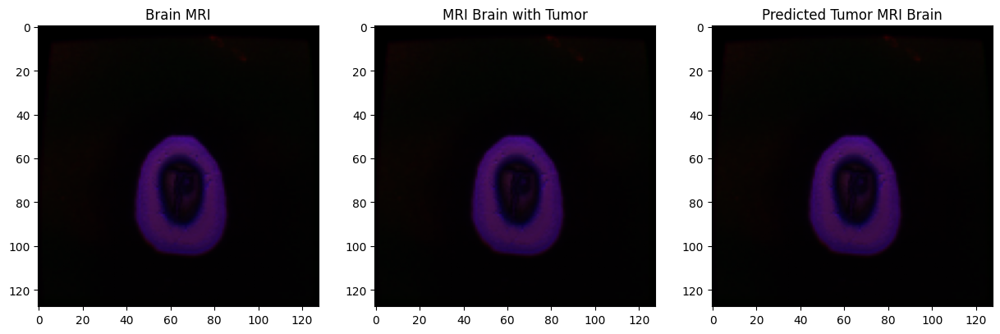

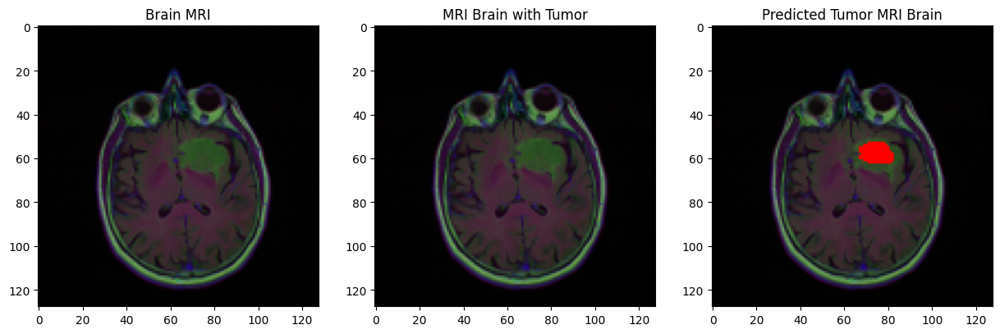

In [ ]:
for i in range(1,40,2):
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    msk= cv2.imread(msk_path_test)
    pred = model.predict(img) #predictions
    img = np.squeeze(img)

    #Plot the Brain MRI scans
    original = img.copy()
    fig, ax = plt.subplots(1,3, figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path_test)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    ax[1].imshow(np.squeeze(sample_over_gt))
    ax[1].set_title("MRI Brain with Tumor")

    #Plot the predicted mask on the Brain MRI Scan
    main = original.copy()
    sample = np.array(np.squeeze(pred) > 0.5, dtype = np.uint8)
    contours, hier = cv2.findContours(sample,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_pr = cv2.drawContours(main, contours, -1, [255,0,0], thickness=-1)
    ax[2].imshow(np.squeeze(sample_over_pr))
    ax[2].set_title("Predicted Tumor MRI Brain")

1/1 [==============================] - 0s 69ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 20ms/step


<ipython-input-79-7b8c258e051e>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,3, figsize = (15,5))


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


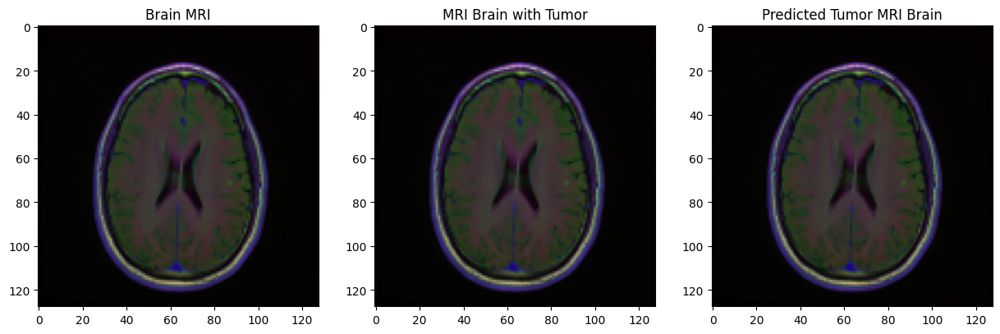

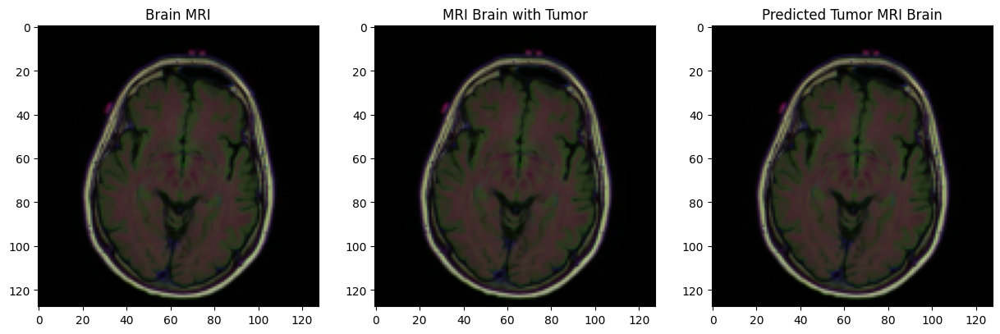

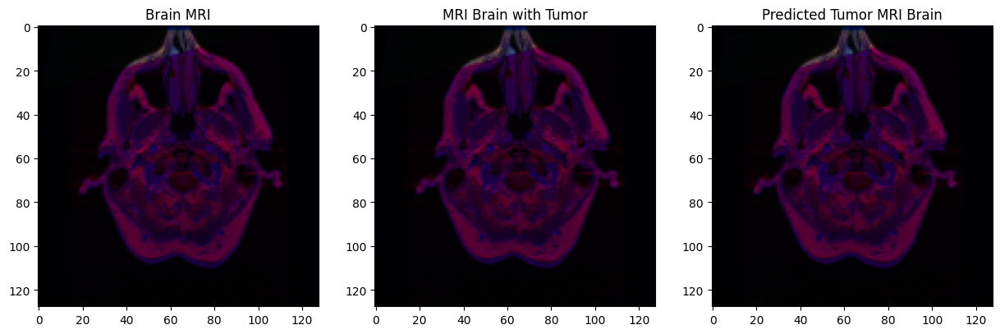

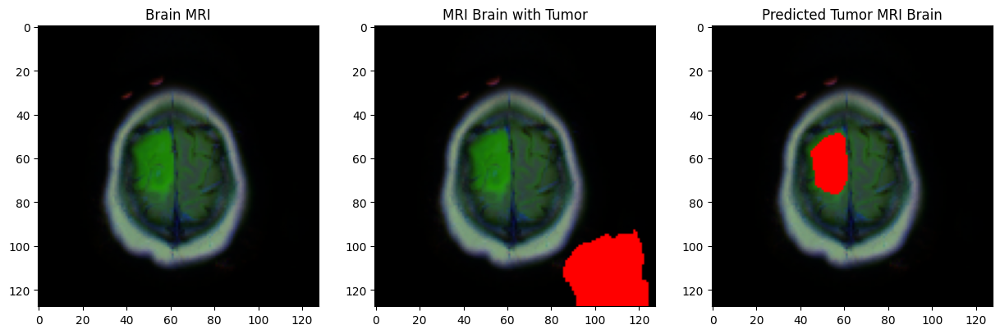

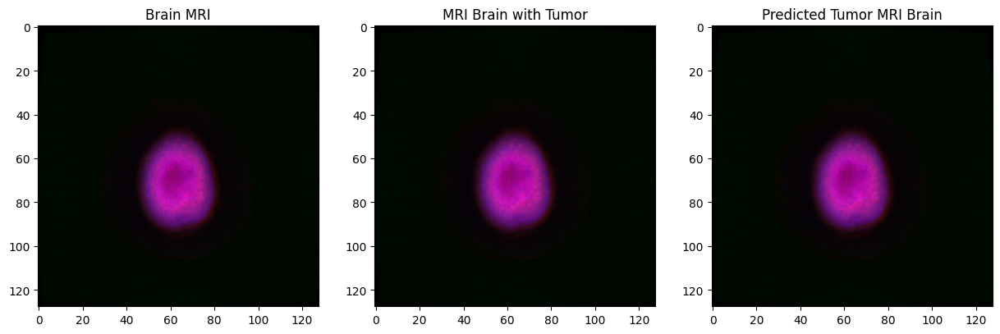

...

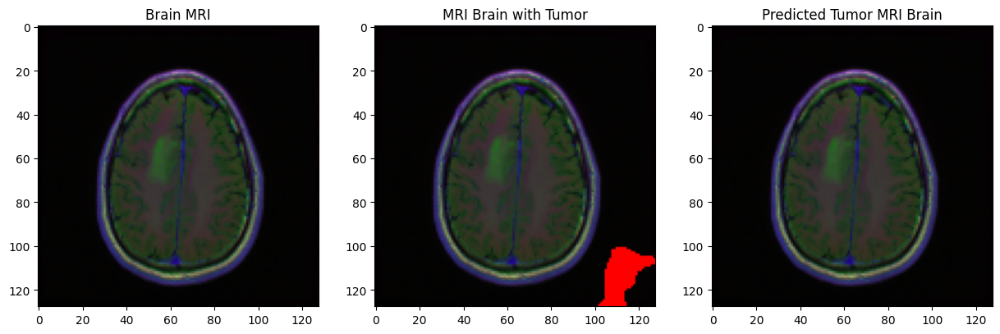

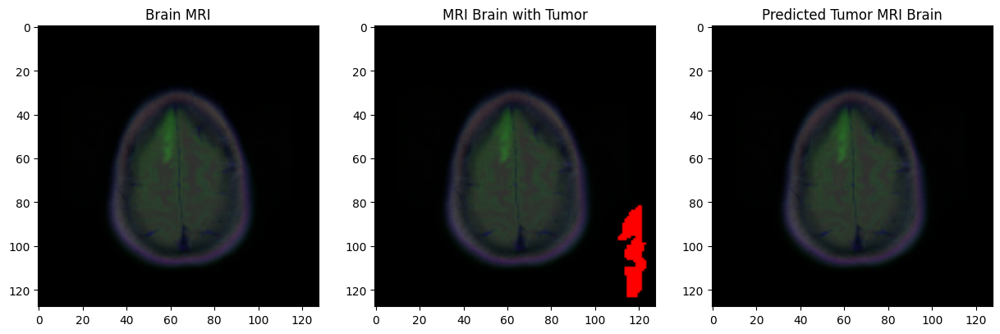

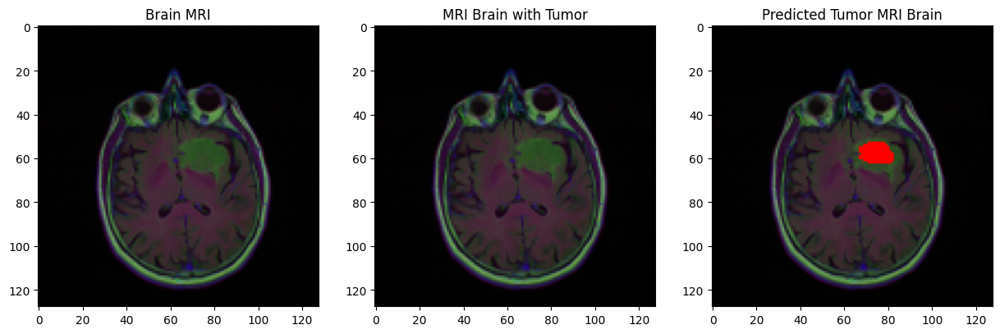

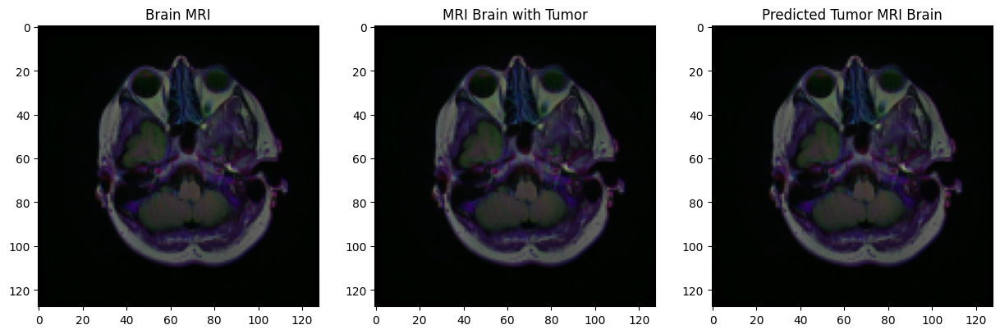

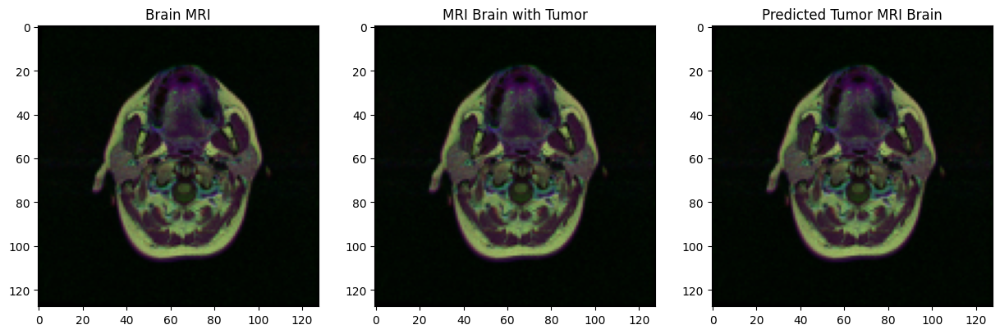

In [ ]:
import random

random.seed(42)
selected_indices = random.sample(range(len(test)), 40)
for i in selected_indices:
    img_path_test = test.iloc[i, 0]
    msk_path_test = test.iloc[i, 1]
    img = cv2.imread(img_path_test)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    img = cv2.resize(img ,(im_height, im_width))
    img = img / 255
    img = img[np.newaxis, :, :, :]
    msk= cv2.imread(msk_path_test)
    pred = model.predict(img) #predictions
    img = np.squeeze(img)

    #Plot the Brain MRI scans
    original = img.copy()
    fig, ax = plt.subplots(1,3, figsize = (15,5))
    ax[0].imshow(original)
    ax[0].set_title("Brain MRI")

    # Plot the Brain MRI scan with their mask
    main = original.copy()
    label = cv2.imread(msk_path_test)
    sample = np.array(np.squeeze(label), dtype = np.uint8)
    contours, hier = cv2.findContours(sample[:,:,0],cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_gt = cv2.drawContours(main, contours, -1,[255,0,0], thickness=-1)
    ax[1].imshow(np.squeeze(sample_over_gt))
    ax[1].set_title("MRI Brain with Tumor")

    #Plot the predicted mask on the Brain MRI Scan
    main = original.copy()
    sample = np.array(np.squeeze(pred) > 0.5, dtype = np.uint8)
    contours, hier = cv2.findContours(sample,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)
    sample_over_pr = cv2.drawContours(main, contours, -1, [255,0,0], thickness=-1)
    ax[2].imshow(np.squeeze(sample_over_pr))
    ax[2].set_title("Predicted Tumor MRI Brain")

In [ ]:
selected_indices

[163,
 28,
 6,
 189,
 70,
 62,
 57,
 35,
 188,
 26,
 173,
 139,
 22,
 151,
 108,
 8,
 7,
 23,
 55,
 59,
 129,
 154,
 197,
 143,
 50,
 166,
 191,
 107,
 56,
 114,
 150,
 71,
 1,
 40,
 185,
 87,
 168,
 39,
 181,
 86]

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define a function to visualize the segmentation masks
def visualize_segmentation(image, mask, title):
    plt.figure(figsize=(10, 5))

    # Display the original image
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Original Image')

    # Display the predicted mask
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap='binary')
    plt.title('Predicted Mask')

    plt.suptitle(title)
    plt.show()

# Generate predictions for the test set
predictions = model.predict(test_gen, steps=len(test) // BATCH_SIZE)

# Iterate through the test images and visualize the results
for i in range(min((len(test),10))):
    image, mask = next(test_gen)
    title = f'Test Image {i+1}'
    visualize_segmentation(image[0], mask[0], title)

# Calculate and print the average loss, IOU, and Dice coefficient
test_loss, test_iou, test_dice = results[0], results[1], results[2]
print("Test Loss:", test_loss)
print("Test IOU:", test_iou)
print("Test Dice Coefficient:", test_dice)


In [ ]:
test_gen = train_generator(test,
                           BATCH_SIZE,
                           dict(),
                           target_size=(im_height, im_width))

200

1/1 [==============================] - 0s 23ms/step


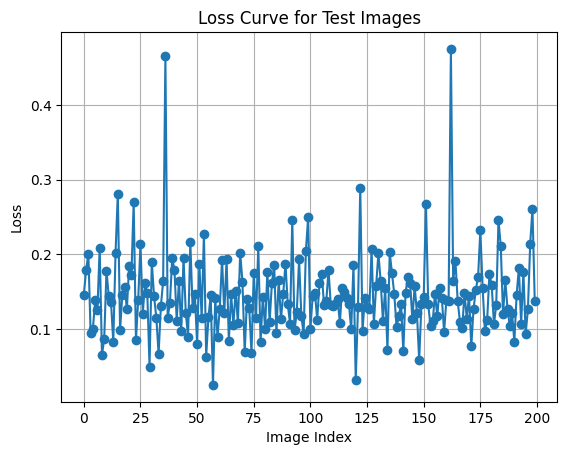

In [ ]:
import matplotlib.pyplot as plt

# Initialize lists to store loss values and image indices
loss_values = []
image_indices = []

# Iterate through the test images
for i in range(min(len(test),30000)):
    image, mask = next(test_gen)

    # Obtain the prediction from the model
    prediction = model.predict(image)

    # Calculate the loss between the predicted mask and the ground truth mask
    loss_tensor = combined_loss(mask, prediction)
    loss = tf.reduce_mean(loss_tensor).numpy()
     # You need to define this function
    # print(loss)

    # Append the loss value and image index to the lists
    loss_values.append(loss)
    image_indices.append(i)
    # break

# print("Image Indices Shape:", len(image_indices), "Loss Values Shape:", len(loss_values), len(loss_values[0]), image_indices[0])
# Plot the loss curve
plt.plot(image_indices, loss_values, marker='o')
plt.xlabel('Image Index')
plt.ylabel('Loss')
plt.title('Loss Curve for Test Images')
plt.grid(True)
plt.show()


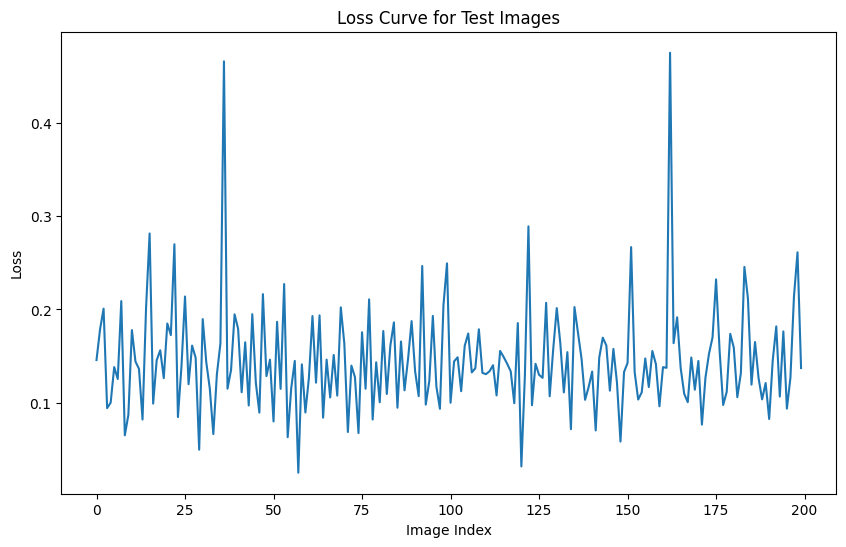

In [ ]:
# plt.subplot(1,4,4)
plt.figure(figsize=(10, 6))
plt.plot(image_indices, loss_values)
plt.xlabel('Image Index')
plt.ylabel('Loss')
plt.title('Loss Curve for Test Images')
# plt.grid(True)
plt.show()



# plt.subplot(1,2,2)
# plt.plot(list_valjaccard, 'b-', label= 'val_jac')
# plt.plot(list_trainjaccard, 'r-', label= 'train_dtrain_jacice_coef')
# plt.xlabel('Epochs')
# plt.ylabel('accuracy')
# plt.title('Dice coefficient', fontsize = 15)
# plt.legend(['train', 'val'])
# plt.legend(loc='best')
# plt.show()


In [ ]:
print("Image Indices Shape:", len(image_indices), "Loss Values Shape:", len(loss_values), len(loss_values[0]), image_indices[3])
print(loss_values[0])

Image Indices Shape: 10 Loss Values Shape: 10 32 3
tf.Tensor(
[[[0.11389637 0.11389792 0.1139015  ... 0.11390102 0.1138978  0.11389771]
  [0.11389726 0.1139012  0.11390474 ... 0.11390352 0.11389989 0.11389807]
  [0.1139003  0.11390507 0.11390987 ... 0.11390531 0.11390433 0.11390159]
  ...
  [0.11389703 0.11390209 0.11390918 ... 0.11390671 0.11390239 0.11390007]
  [0.11389542 0.11389852 0.11390138 ... 0.1139017  0.11389887 0.11389688]
  [0.11389506 0.11389577 0.11389729 ... 0.1138989  0.11389685 0.11389807]]

 [[0.11389643 0.11389801 0.11390164 ... 0.11390156 0.11389807 0.11389789]
  [0.11389735 0.11390123 0.11390471 ... 0.11390415 0.11390036 0.11389837]
  [0.11390039 0.11390513 0.11390972 ... 0.11390525 0.11390498 0.11390209]
  ...
  [0.11389729 0.11390206 0.11390978 ... 0.11390615 0.11390275 0.11390063]
  [0.11389554 0.11389866 0.11390176 ... 0.11390224 0.11389908 0.11389711]
  [0.11389512 0.11389592 0.11389762 ... 0.11389941 0.11389714 0.11389825]]

 [[0.11389622 0.11389765 0.1139010

In [ ]:
import numpy as np
from keras.callbacks import ModelCheckpoint
from keras.optimizers import Adam

# Define the number of epochs for each batch
batch_epochs = 10
total_epochs = 50

# # Initialize an empty dictionary to store the accumulated training history
accumulated_history = {}

# # Initialize variables to keep track of the current batch and epoch
current_batch = 0
lr = 0.0001
for i in range(total_epochs // batch_epochs):
    print(f"Training for epochs {current_batch + 1} to {current_batch + batch_epochs}")
    # Load or create a new model
    if current_batch == 0:
        model = unet_plus(input=(im_height, im_width, 3),num_classes=2, deep_supervision=True)
    else:
        # Load the model weights from the previous run
        model.load_weights(f"/content/drive/My Drive/tifr_notebook/unet++_model_weights_epoch_l_{current_batch}.h5")

    # Compile the model
    optimizer = Adam(learning_rate=lr)
    model.compile(optimizer=optimizer, loss=combined_loss, metrics=["binary_accuracy", iou, dice_coef])

    # Set up callbacks to save model weights after each batch of epochs
    checkpoint = ModelCheckpoint(f"/content/drive/My Drive/tifr_notebook/unet++_model_weights_epoch_l_{current_batch + batch_epochs}.h5",
                                 monitor='val_loss',
                                 save_best_only=True,
                                 mode='min')

    # Train the model for the current batch of epochs
    history = model.fit(train_gen,
                        steps_per_epoch=len(train) // BATCH_SIZE,
                        epochs=batch_epochs,
                        validation_data=test_gen,
                        validation_steps=len(val) // BATCH_SIZE,
                        callbacks=[checkpoint])

    # Accumulate the training history
    for key in history.history:
        if key not in accumulated_history:
            accumulated_history[key] = []
        accumulated_history[key].extend(history.history[key])

    # Update the current batch number
    current_batch += batch_epochs
    print("cuurent running batch:",current_batch)
    np.save(f"/content/drive/My Drive/tifr_notebook/unet++_accumulated_history_l_{current_batch + batch_epochs}.npy", accumulated_history)

# Save the accumulated training history
np.save("/content/drive/My Drive//tifr_notebook/unet++_accumulated_history_l.npy", accumulated_history)

Training for epochs 1 to 10
Epoch 1/10
45/45 [==============================] - 88s 2s/step - loss: -0.4533 - binary_accuracy: 0.7157 - iou: -0.1644 - dice_coef: -0.0013 - val_loss: -0.3257 - val_binary_accuracy: 0.9885 - val_iou: 0.0089 - val_dice_coef: 0.0176
Epoch 2/10
45/45 [==============================] - 66s 1s/step - loss: -0.5179 - binary_accuracy: 0.5122 - iou: -0.0487 - dice_coef: -0.1093 - val_loss: -0.3557 - val_binary_accuracy: 0.9763 - val_iou: 0.0100 - val_dice_coef: 0.0193
Epoch 3/10
45/45 [==============================] - 59s 1s/step - loss: -0.7110 - binary_accuracy: 0.5360 - iou: 0.1817 - dice_coef: 0.3298 - val_loss: -0.3535 - val_binary_accuracy: 0.6591 - val_iou: -0.1684 - val_dice_coef: -0.0159
Epoch 4/10
45/45 [==============================] - 72s 2s/step - loss: -0.3849 - binary_accuracy: 0.5849 - iou: -0.1329 - dice_coef: -0.3381 - val_loss: -0.4147 - val_binary_accuracy: 0.6362 - val_iou: -0.0188 - val_dice_coef: -0.0421
Epoch 5/10
45/45 [================

## Unet

In [ ]:
def unet(input_size=(128,128,3)):

    # Input
    inputs = Input(input_size)

    # Stage 1
    conv1 = Conv2D(64, (3, 3), padding='same')(inputs)
    bn1 = Activation('relu')(conv1)
    conv1 = Conv2D(64, (3, 3), padding='same')(bn1)
    bn1 = BatchNormalization(axis=3)(conv1)
    bn1 = Activation('relu')(bn1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(bn1)

    # Stage 2
    conv2 = Conv2D(128, (3, 3), padding='same')(pool1)
    bn2 = Activation('relu')(conv2)
    conv2 = Conv2D(128, (3, 3), padding='same')(bn2)
    bn2 = BatchNormalization(axis=3)(conv2)
    bn2 = Activation('relu')(bn2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(bn2)

    # Stage 3
    conv3 = Conv2D(256, (3, 3), padding='same')(pool2)
    bn3 = Activation('relu')(conv3)
    conv3 = Conv2D(256, (3, 3), padding='same')(bn3)
    bn3 = BatchNormalization(axis=3)(conv3)
    bn3 = Activation('relu')(bn3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(bn3)

    # Stage 4
    conv4 = Conv2D(512, (3, 3), padding='same')(pool3)
    bn4 = Activation('relu')(conv4)
    conv4 = Conv2D(512, (3, 3), padding='same')(bn4)
    bn4 = BatchNormalization(axis=3)(conv4)
    bn4 = Activation('relu')(bn4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(bn4)

    # Stage 5
    conv5 = Conv2D(1024, (3, 3), padding='same')(pool4)
    bn5 = Activation('relu')(conv5)
    conv5 = Conv2D(1024, (3, 3), padding='same')(bn5)
    bn5 = BatchNormalization(axis=3)(conv5)
    bn5 = Activation('relu')(bn5)

    # Upstage 1
    up6 = concatenate([Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(bn5), conv4], axis=3)
    conv6 = Conv2D(512, (3, 3), padding='same')(up6)
    bn6 = Activation('relu')(conv6)
    conv6 = Conv2D(512, (3, 3), padding='same')(bn6)
    bn6 = BatchNormalization(axis=3)(conv6)
    bn6 = Activation('relu')(bn6)

    # Upstage 2
    up7 = concatenate([Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(bn6), conv3], axis=3)
    conv7 = Conv2D(256, (3, 3), padding='same')(up7)
    bn7 = Activation('relu')(conv7)
    conv7 = Conv2D(256, (3, 3), padding='same')(bn7)
    bn7 = BatchNormalization(axis=3)(conv7)
    bn7 = Activation('relu')(bn7)

    # Upstage 3
    up8 = concatenate([Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(bn7), conv2], axis=3)
    conv8 = Conv2D(128, (3, 3), padding='same')(up8)
    bn8 = Activation('relu')(conv8)
    conv8 = Conv2D(128, (3, 3), padding='same')(bn8)
    bn8 = BatchNormalization(axis=3)(conv8)
    bn8 = Activation('relu')(bn8)

    # Upstage 4
    up9 = concatenate([Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(bn8), conv1], axis=3)
    conv9 = Conv2D(64, (3, 3), padding='same')(up9)
    bn9 = Activation('relu')(conv9)
    conv9 = Conv2D(64, (3, 3), padding='same')(bn9)
    bn9 = BatchNormalization(axis=3)(conv9)
    bn9 = Activation('relu')(bn9)

    # Output
    conv10 = Conv2D(1, (1, 1), activation='sigmoid')(bn9)

    return Model(inputs=[inputs], outputs=[conv10])

In [ ]:
learning_rate = 0.01

In [ ]:
import numpy as np
from keras.callbacks import ModelCheckpoint
from keras.optimizers import Adam

# Define the number of epochs for each batch
batch_epochs = 10
total_epochs = 50

# # Initialize an empty dictionary to store the accumulated training history
accumulated_history = {}

# # Initialize variables to keep track of the current batch and epoch
current_batch = 0

for i in range(total_epochs // batch_epochs):
    print(f"Training for epochs {current_batch + 1} to {current_batch + batch_epochs}")
    # Load or create a new model
    if current_batch == 0:
        model = unet(input_size=(im_height, im_width, 3))
    else:
        # Load the model weights from the previous run
        model.load_weights(f"/content/drive/My Drive/tifr_notebook/model_weights_epoch_l_{current_batch}.h5")

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer= optimizer, loss=dice_coef_loss, metrics=["binary_accuracy", iou, dice_coef])

    # Set up callbacks to save model weights after each batch of epochs
    checkpoint = ModelCheckpoint(f"/content/drive/My Drive/tifr_notebook/model_weights_epoch_l_{current_batch + batch_epochs}.h5",
                                 monitor='val_loss',
                                 save_best_only=True,
                                 mode='min')

    # Train the model for the current batch of epochs
    history = model.fit(train_gen,
                        steps_per_epoch=len(train) // BATCH_SIZE,
                        epochs=batch_epochs,
                        validation_data=test_gen,
                        validation_steps=len(val) // BATCH_SIZE,
                        callbacks=[checkpoint])

    # Accumulate the training history
    for key in history.history:
        if key not in accumulated_history:
            accumulated_history[key] = []
        accumulated_history[key].extend(history.history[key])

    # Update the current batch number
    current_batch += batch_epochs
    print("cuurent running batch:",current_batch)
    np.save(f"/content/drive/My Drive/tifr_notebook/accumulated_history_l_{current_batch + batch_epochs}.npy", accumulated_history)

# Save the accumulated training history
np.save("/content/drive/My Drive/tifr_notebook/accumulated_history_l.npy", accumulated_history)


Training for epochs 1 to 10
Epoch 1/10
45/45 [==============================] - 36s 633ms/step - loss: -0.1956 - binary_accuracy: 0.8640 - iou: 0.1173 - dice_coef: 0.1956 - val_loss: -0.0170 - val_binary_accuracy: 0.0851 - val_iou: 0.0088 - val_dice_coef: 0.0172
Epoch 2/10
45/45 [==============================] - 30s 665ms/step - loss: -0.3709 - binary_accuracy: 0.9827 - iou: 0.2394 - dice_coef: 0.3709 - val_loss: -0.3533 - val_binary_accuracy: 0.9851 - val_iou: 0.2500 - val_dice_coef: 0.3761
Epoch 3/10
45/45 [==============================] - 21s 458ms/step - loss: -0.4269 - binary_accuracy: 0.9852 - iou: 0.2858 - dice_coef: 0.4269 - val_loss: -0.3410 - val_binary_accuracy: 0.9905 - val_iou: 0.2196 - val_dice_coef: 0.3319
Epoch 4/10
45/45 [==============================] - 21s 458ms/step - loss: -0.4643 - binary_accuracy: 0.9872 - iou: 0.3157 - dice_coef: 0.4643 - val_loss: -0.3021 - val_binary_accuracy: 0.9926 - val_iou: 0.1998 - val_dice_coef: 0.2900
Epoch 5/10
45/45 [==============

In [ ]:
# model = unet_plus(input=(im_height, im_width, 3))


# model.compile(optimizer='adam', loss=dice_coef_loss, metrics=["binary_accuracy", iou, dice_coef])

# history = model.fit(train_gen,
#                     steps_per_epoch = len(train) / BATCH_SIZE,
#                     epochs=EPOCHS,
#                     validation_data = test_gen,
#                     validation_steps = len(val) / BATCH_SIZE,
#                     callbacks = callbacks)

In [ ]:
history_path = "/content/drive/My Drive/tifr_notebook/accumulated_history_l.npy"
batch_history = np.load(history_path, allow_pickle=True).item()

In [ ]:
len(batch_history['dice_coef'])

50

In [ ]:
history_path = "/content/drive/My Drive/tifr_notebook/accumulated_history_l_20.npy"
batch_history = np.load(history_path, allow_pickle=True).item()
len(batch_history['dice_coef'])

10

In [ ]:
import numpy as np
accumulated_history = {}
# /content/drive/My Drive/accumulated_history_l
for epoch_batch in range(20, 70, 10):
    # Load the history of the current batch
    history_path = f"/content/drive/My Drive/tifr_notebook/accumulated_history_l_{epoch_batch}.npy"
    batch_history = np.load(history_path, allow_pickle=True).item()
    print(f"/content/drive/My Drive/tifr_notebook/accumulated_history_l_{epoch_batch}.npy",len(batch_history['dice_coef']))

    for key, value in batch_history.items():
        if key in accumulated_history:
            accumulated_history[key].extend(value)
        else:
            accumulated_history[key] = value

/content/drive/My Drive/tifr_notebook/accumulated_history_l_20.npy 10
/content/drive/My Drive/tifr_notebook/accumulated_history_l_30.npy 20
/content/drive/My Drive/tifr_notebook/accumulated_history_l_40.npy 30
/content/drive/My Drive/tifr_notebook/accumulated_history_l_50.npy 40
/content/drive/My Drive/tifr_notebook/accumulated_history_l_60.npy 50


In [ ]:
history=batch_history

In [ ]:
len(history['dice_coef'])

50

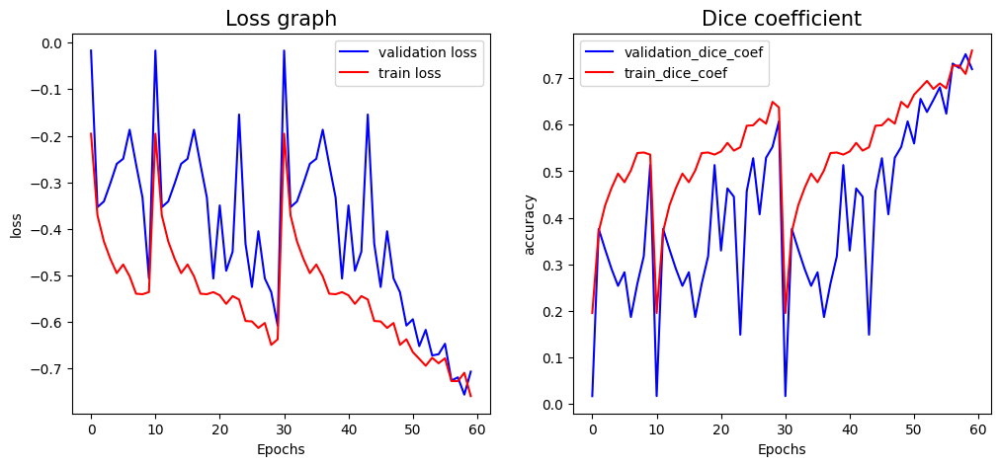

In [ ]:
import matplotlib.pyplot as plt

list_traindice = history['dice_coef']
list_valdice = history['val_dice_coef']

list_trainjaccard = history['iou']
list_valjaccard = history['val_iou']

list_trainloss = history['loss']
list_valloss = history['val_loss']

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(list_valloss, 'b-', label='validation loss')
plt.plot(list_trainloss,'r-', label='train loss')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title('Loss graph', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(list_valdice, 'b-', label= 'validation_dice_coef')
plt.plot(list_traindice, 'r-', label= 'train_dice_coef')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('Dice coefficient', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
plt.show()

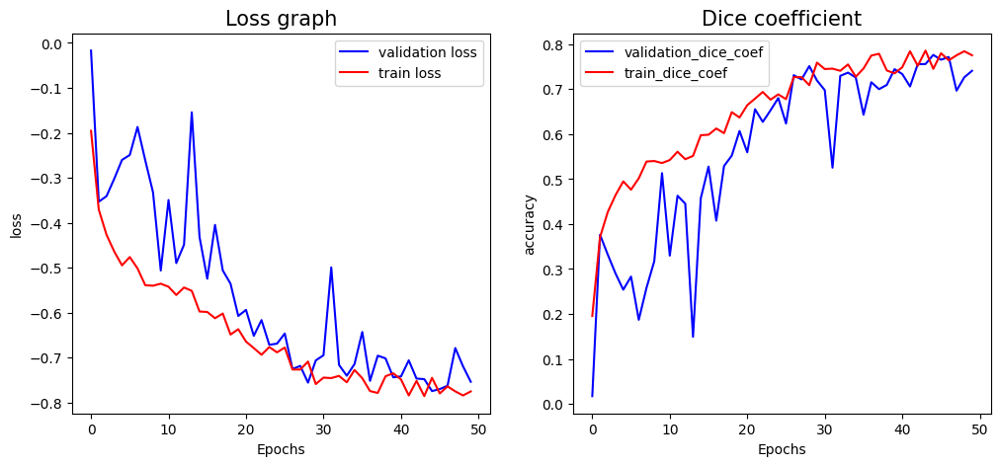

In [ ]:
import matplotlib.pyplot as plt

list_traindice = history['dice_coef']
list_valdice = history['val_dice_coef']

list_trainjaccard = history['iou']
list_valjaccard = history['val_iou']

list_trainloss = history['loss']
list_valloss = history['val_loss']

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(list_valloss, 'b-', label='validation loss')
plt.plot(list_trainloss,'r-', label='train loss')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title('Loss graph', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')

plt.subplot(1,2,2)
plt.plot(list_valdice, 'b-', label= 'validation_dice_coef')
plt.plot(list_traindice, 'r-', label= 'train_dice_coef')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.title('Dice coefficient', fontsize = 15)
plt.legend(['train', 'val'])
plt.legend(loc='best')
plt.show()